In [1]:
!pip install segmentation-models-pytorch
!pip install -U git+https://github.com/albumentations-team/albumentations
!pip install --upgrade opencv-contrib-python
!wget -c https://raw.githubusercontent.com/udacity/deep-learning-v2-pytorch/master/intro-to-pytorch/helper.py
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://drive.google.com/uc?export=download&id=1XOBoRGSraP50_pS1YPB8_i8Wmw_5L-NG' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1XOBoRGSraP50_pS1YPB8_i8Wmw_5L-NG" -O 'tmp' && rm -rf /tmp/cookies.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.7/106.7 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 32.5 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16428 sha256=5fd75072e35f9010fef74176bb45488c7f3fb88b4276ade9937fb37ded2eb758
  Stored in directory: /root/.cache/pip/wheels/03/3f/e9/911b1bc46869644912bda90a56bcf7b960f20b5187feea3baf
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60945 sha256=c1e059b3addf1b22f3969a05385f74936c7dec8d8ebd9cd6368cc3a7cef60529
  Stored in directory: /root/.cache/pip/wheels/35/cb/a5/8f534c60142835bfc889f9a482e4a67e0b817032d9c6883b64
Successfully built efficientnet-pytorch pretrainedmodels
  Cloning https://github.com/albumentations-team/albumenta

In [2]:
import torch
import cv2

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from tqdm import tqdm

import helper

from torch.utils.data import Dataset
import os
import numpy as np
from glob import glob
import tensorflow as tf
from torch.utils.data import DataLoader
from torch import nn
import segmentation_models_pytorch as smp
from segmentation_models_pytorch.losses import DiceLoss

In [3]:
if not os.path.exists('image'):
    os.makedirs('image')

In [4]:
!tar -xvf  '/content/tmp' -C '/content/image'

เอาต์พุตของการสตรีมมีการตัดเหลือเพียง 5000 บรรทัดสุดท้าย
LaPa/train/labels/2818584124_13.png
LaPa/train/labels/LFPW_image_test_0157_1.png
LaPa/train/labels/4595280121_4.png
LaPa/train/labels/HELEN_2761106136_1_3.png
LaPa/train/labels/HELEN_3005087184_1_0.png
LaPa/train/labels/5906318280_1.png
LaPa/train/labels/HELEN_126968967_1_0.png
LaPa/train/labels/LFPW_image_test_0157_2.png
LaPa/train/labels/AFW_5002723411_2_9.png
LaPa/train/labels/LFPW_image_train_0292_6.png
LaPa/train/labels/12016442526_0.png
LaPa/train/labels/LFPW_image_train_0789_7.png
LaPa/train/labels/LFPW_image_train_0588_0.png
LaPa/train/labels/HELEN_173808384_2_5.png
LaPa/train/labels/6531382301_15.png
LaPa/train/labels/HELEN_2707642369_1_4.png
LaPa/train/labels/12268264184_13.png
LaPa/train/labels/71244599_2.png
LaPa/train/labels/6259612800_2.png
LaPa/train/labels/AFW_4906266640_1_1.png
LaPa/train/labels/HELEN_2414075021_1_0.png
LaPa/train/labels/HELEN_2233737284_1_3.png
LaPa/train/labels/HELEN_1419222657_1_1.png
LaPa/tra

## Download file testing enhanment

In [5]:
!wget "https://drive.google.com/uc?export=download&id=1WeP0mTjUDBt2Zx4JWO0U0xf15jwpsr6V" -O "test-im"

--2023-12-13 03:11:52--  https://drive.google.com/uc?export=download&id=1WeP0mTjUDBt2Zx4JWO0U0xf15jwpsr6V
Resolving drive.google.com (drive.google.com)... 173.194.174.100, 173.194.174.102, 173.194.174.101, ...
Connecting to drive.google.com (drive.google.com)|173.194.174.100|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0o-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8rd23tk0jhuaih4hb8eip1utlp796dca/1702437075000/01106086328674120706/*/1WeP0mTjUDBt2Zx4JWO0U0xf15jwpsr6V?e=download&uuid=765b08aa-05df-477f-beb5-38b38182a396 [following]
--2023-12-13 03:11:55--  https://doc-0o-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8rd23tk0jhuaih4hb8eip1utlp796dca/1702437075000/01106086328674120706/*/1WeP0mTjUDBt2Zx4JWO0U0xf15jwpsr6V?e=download&uuid=765b08aa-05df-477f-beb5-38b38182a396
Resolving doc-0o-3c-docs.googleusercontent.com (doc-0o-3c-docs.googleusercontent.com)... 108.177.125.132, 

In [6]:
!unzip 'test-im' -d 'archive'

Archive:  test-im
  inflating: archive/1 (1).jpg       
  inflating: archive/1 (10).jpg      
  inflating: archive/1 (100).jpg     
  inflating: archive/1 (11).jpg      
  inflating: archive/1 (12).jpg      
  inflating: archive/1 (13).jpg      
  inflating: archive/1 (14).jpg      
  inflating: archive/1 (15).jpg      
  inflating: archive/1 (16).jpg      
  inflating: archive/1 (17).jpg      
  inflating: archive/1 (18).jpg      
  inflating: archive/1 (19).jpg      
  inflating: archive/1 (2).jpg       
  inflating: archive/1 (20).jpg      
  inflating: archive/1 (21).jpg      
  inflating: archive/1 (22).jpg      
  inflating: archive/1 (23).jpg      
  inflating: archive/1 (24).jpg      
  inflating: archive/1 (25).jpg      
  inflating: archive/1 (26).jpg      
  inflating: archive/1 (27).jpg      
  inflating: archive/1 (28).jpg      
  inflating: archive/1 (29).jpg      
  inflating: archive/1 (3).jpg       
  inflating: archive/1 (30).jpg      
  inflating: archive/1 (31).jpg 

In [7]:
!wget 'https://drive.google.com/uc?export=download&id=1-sr6XByGYKRdIDuS3MjAWCBnhX1_OnGG' -O "test-mark"

--2023-12-13 03:11:57--  https://drive.google.com/uc?export=download&id=1-sr6XByGYKRdIDuS3MjAWCBnhX1_OnGG
Resolving drive.google.com (drive.google.com)... 173.194.174.100, 173.194.174.102, 173.194.174.101, ...
Connecting to drive.google.com (drive.google.com)|173.194.174.100|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0s-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/sitne6lilnj8e9hbegcrhsu21v5l99ue/1702437075000/01106086328674120706/*/1-sr6XByGYKRdIDuS3MjAWCBnhX1_OnGG?e=download&uuid=980d184b-e18b-481c-9b94-cc00709aca5b [following]
--2023-12-13 03:11:58--  https://doc-0s-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/sitne6lilnj8e9hbegcrhsu21v5l99ue/1702437075000/01106086328674120706/*/1-sr6XByGYKRdIDuS3MjAWCBnhX1_OnGG?e=download&uuid=980d184b-e18b-481c-9b94-cc00709aca5b
Resolving doc-0s-3c-docs.googleusercontent.com (doc-0s-3c-docs.googleusercontent.com)... 108.177.125.132, 

In [8]:
!unzip "test-mark" -d "markup"

Archive:  test-mark
  inflating: markup/1 (1).jpg        
  inflating: markup/1 (10).jpg       
  inflating: markup/1 (100).jpg      
  inflating: markup/1 (11).jpg       
  inflating: markup/1 (12).jpg       
  inflating: markup/1 (13).jpg       
  inflating: markup/1 (14).jpg       
  inflating: markup/1 (15).jpg       
  inflating: markup/1 (16).jpg       
  inflating: markup/1 (17).jpg       
  inflating: markup/1 (18).jpg       
  inflating: markup/1 (19).jpg       
  inflating: markup/1 (2).jpg        
  inflating: markup/1 (20).jpg       
  inflating: markup/1 (21).jpg       
  inflating: markup/1 (22).jpg       
  inflating: markup/1 (23).jpg       
  inflating: markup/1 (24).jpg       
  inflating: markup/1 (25).jpg       
  inflating: markup/1 (26).jpg       
  inflating: markup/1 (27).jpg       
  inflating: markup/1 (28).jpg       
  inflating: markup/1 (29).jpg       
  inflating: markup/1 (3).jpg        
  inflating: markup/1 (30).jpg       
  inflating: markup/1 (31).jpg

In [9]:
!wget "https://drive.google.com/uc?export=download&id=1K0QTK_GSyai5vNwMgaO3Kh54n5w4Sjtx" -O "face-mark"

--2023-12-13 03:11:58--  https://drive.google.com/uc?export=download&id=1K0QTK_GSyai5vNwMgaO3Kh54n5w4Sjtx
Resolving drive.google.com (drive.google.com)... 173.194.174.100, 173.194.174.102, 173.194.174.101, ...
Connecting to drive.google.com (drive.google.com)|173.194.174.100|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0g-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/4vv0k7e9qvktd5re8q53re33tpqoat2a/1702437075000/01106086328674120706/*/1K0QTK_GSyai5vNwMgaO3Kh54n5w4Sjtx?e=download&uuid=e15b1ab9-2a2a-4bb2-a115-b28d62cee8dd [following]
--2023-12-13 03:12:01--  https://doc-0g-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/4vv0k7e9qvktd5re8q53re33tpqoat2a/1702437075000/01106086328674120706/*/1K0QTK_GSyai5vNwMgaO3Kh54n5w4Sjtx?e=download&uuid=e15b1ab9-2a2a-4bb2-a115-b28d62cee8dd
Resolving doc-0g-3c-docs.googleusercontent.com (doc-0g-3c-docs.googleusercontent.com)... 108.177.125.132, 

In [10]:
!unzip "face-mark" -d 'face-m'

Archive:  face-mark
  inflating: face-m/1 (1).jpg        
  inflating: face-m/1 (10).jpg       
  inflating: face-m/1 (100).jpg      
  inflating: face-m/1 (11).jpg       
  inflating: face-m/1 (12).jpg       
  inflating: face-m/1 (13).jpg       
  inflating: face-m/1 (14).jpg       
  inflating: face-m/1 (15).jpg       
  inflating: face-m/1 (16).jpg       
  inflating: face-m/1 (17).jpg       
  inflating: face-m/1 (18).jpg       
  inflating: face-m/1 (19).jpg       
  inflating: face-m/1 (2).jpg        
  inflating: face-m/1 (20).jpg       
  inflating: face-m/1 (21).jpg       
  inflating: face-m/1 (22).jpg       
  inflating: face-m/1 (23).jpg       
  inflating: face-m/1 (24).jpg       
  inflating: face-m/1 (25).jpg       
  inflating: face-m/1 (26).jpg       
  inflating: face-m/1 (27).jpg       
  inflating: face-m/1 (28).jpg       
  inflating: face-m/1 (29).jpg       
  inflating: face-m/1 (3).jpg        
  inflating: face-m/1 (30).jpg       
  inflating: face-m/1 (31).jpg

## Initialize Model

In [11]:
DATA_DIR = "image/LaPa"
DEVICE = 'cpu'
ENCODER = 'resnext101_32x48d'
WEIGHTS = 'instagram'
IMAGE_SIZE = 224
num_classes = 11
BATCH_SIZE = 64

In [12]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://drive.google.com/uc?export=download&id=1_fdYp8trR7mMDWeqjHOhTASp4SQv7RSk' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1_fdYp8trR7mMDWeqjHOhTASp4SQv7RSk" -O 'best_model' && rm -rf /tmp/cookies.txt

--2023-12-13 03:12:02--  https://docs.google.com/uc?export=download&confirm=t&id=1_fdYp8trR7mMDWeqjHOhTASp4SQv7RSk
Resolving docs.google.com (docs.google.com)... 74.125.23.102, 74.125.23.139, 74.125.23.101, ...
Connecting to docs.google.com (docs.google.com)|74.125.23.102|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-14-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/82v00nu1ot85u9hoqqjq95q6a3o19h5v/1702437075000/01106086328674120706/*/1_fdYp8trR7mMDWeqjHOhTASp4SQv7RSk?e=download&uuid=81feecda-6536-4721-bb24-2aaa06107702 [following]
--2023-12-13 03:12:03--  https://doc-14-3c-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/82v00nu1ot85u9hoqqjq95q6a3o19h5v/1702437075000/01106086328674120706/*/1_fdYp8trR7mMDWeqjHOhTASp4SQv7RSk?e=download&uuid=81feecda-6536-4721-bb24-2aaa06107702
Resolving doc-14-3c-docs.googleusercontent.com (doc-14-3c-docs.googleusercontent.com)... 108.177.125.132, 240

In [13]:
class SegmentationModel(nn.Module):
  def __init__(self):
    super(SegmentationModel,self).__init__()

    self.arc = smp.Unet(
        encoder_name = ENCODER,
        encoder_weights = WEIGHTS,
        in_channels = 3,
        classes = num_classes,
        activation = None
    )
    for param in self.arc.encoder.parameters():
        param.requires_grad = False
  def forward(self, images, masks = None):
    logits = self.arc(images)

    if masks != None:
      loss1 = DiceLoss(mode="binary")(logits,masks)
      loss2 = nn.CrossEntropyLoss()(logits,masks)
      return logits, loss1 + loss2

    return logits

In [14]:
model = SegmentationModel()
model.to(DEVICE)


Downloading: "https://download.pytorch.org/models/ig_resnext101_32x48-3e41cc8a.pth" to /root/.cache/torch/hub/checkpoints/ig_resnext101_32x48-3e41cc8a.pth
100%|██████████| 3.09G/3.09G [02:46<00:00, 19.9MB/s]


SegmentationModel(
  (arc): Unet(
    (encoder): ResNetEncoder(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 1536, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(1536, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(1536, 1536, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn2): BatchNorm2d(1536, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(1536, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True

In [15]:
model.load_state_dict(torch.load('best_model',map_location=torch.device(DEVICE)))

<All keys matched successfully>

In [16]:
from torchsummary import summary
summary(model, (3, IMAGE_SIZE, IMAGE_SIZE))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5         [-1, 1536, 56, 56]          98,304
       BatchNorm2d-6         [-1, 1536, 56, 56]           3,072
              ReLU-7         [-1, 1536, 56, 56]               0
            Conv2d-8         [-1, 1536, 56, 56]         663,552
       BatchNorm2d-9         [-1, 1536, 56, 56]           3,072
             ReLU-10         [-1, 1536, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]         393,216
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

## Preparing Data

In [17]:
import albumentations as A

In [18]:
def load_dataset(path):
    train_x = sorted(glob(os.path.join(path, "train", "images", "*.jpg")))
    train_y = sorted(glob(os.path.join(path, "train", "labels", "*.png")))

    valid_x = sorted(glob(os.path.join(path, "val", "images", "*.jpg")))
    valid_y = sorted(glob(os.path.join(path, "val", "labels", "*.png")))

    test_x = sorted(glob(os.path.join(path, "test", "images", "*.jpg")))
    test_y = sorted(glob(os.path.join(path, "test", "labels", "*.png")))

    return (train_x, train_y), (valid_x, valid_y), (test_x, test_y)

In [19]:
def get_train_augs():
  return A.Compose([
      A.Resize(IMAGE_SIZE, IMAGE_SIZE),
      A.HorizontalFlip(p = 0.5),
      A.VerticalFlip(p = 0.5)
  ], is_check_shapes=False)

def get_valid_augs():
  return A.Compose([
      A.Resize(IMAGE_SIZE, IMAGE_SIZE),
  ], is_check_shapes=False)

In [20]:
class SegmentationDataset(Dataset):
  def __init__(self, data, augmentations):
    self.DataX= data[0]
    self.DataY =data[1]
    self.augmentations = augmentations

  def __len__(self):
    return len(self.DataX)

  def __getitem__(self, idx):
    image_path = self.DataX[idx]
    mask_path = self.DataY[idx]
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    mask = cv2.imread(mask_path, 0 )
    mask = tf.one_hot(mask, num_classes)
    #mask = np.expand_dims(mask,axis = -1)
    mask = mask.numpy()

    if self.augmentations:
      data = self.augmentations(image = image, mask = mask)
      image = data['image']
      mask = data['mask']

    image = np.transpose(image, (2,0,1)).astype(np.float32)

    mask = np.transpose(mask, (2,0,1)).astype(np.float32)
    image = torch.Tensor(image) / 255.0
    mask = torch.round(torch.Tensor(mask) / 1.0)

    return image, mask

In [21]:
train, val, test = load_dataset(DATA_DIR)
test = SegmentationDataset(test, get_valid_augs())

## custom function

In [22]:
def show_image(image,mask,pred_image = None):

    if pred_image == None:

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5))

        ax1.set_title('IMAGE')
        ax1.imshow(image.permute(1,2,0).squeeze(),cmap = 'gray')

        ax2.set_title('GROUND TRUTH')
        grayscale_images = torch.Tensor(np.argmax(mask.numpy(), axis=0) * (255 / (mask.shape[0] - 1)))
        ax2.imshow(grayscale_images.permute(0,1).squeeze(),cmap = 'gray')

    elif pred_image != None :

        f, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(10,5))

        ax1.set_title('IMAGE')
        ax1.imshow(image.permute(1,2,0).squeeze(),cmap = 'gray')

        ax2.set_title('GROUND TRUTH')
        grayscale_images = torch.Tensor(np.argmax(mask.numpy(), axis=0) * (255 / (mask.shape[0] - 1)))
        ax2.imshow(grayscale_images.permute(0,1).squeeze(),cmap = 'gray')

        ax3.set_title('MODEL OUTPUT')
        pred_image = torch.Tensor(np.argmax(pred_image.numpy(), axis=0) * (255 / (pred_image.shape[0] - 1)))
        ax3.imshow(pred_image.permute(0,1).squeeze(),cmap = 'gray')

## DataLoader

In [23]:
from torch.utils.data import DataLoader

In [24]:
testloader = DataLoader(test, batch_size=BATCH_SIZE)

## Evaluate

In [25]:
model.eval()

SegmentationModel(
  (arc): Unet(
    (encoder): ResNetEncoder(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 1536, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(1536, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(1536, 1536, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn2): BatchNorm2d(1536, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(1536, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True

class 0 = background

class 1 = skin

class 2 = left brown

class 3 = right brown

class 4 = left eye

class 5 = right eye

class 6 = nose

class 7 = upper lip

class 8 = mouth

class 9 = lower lip

class 10 = hair

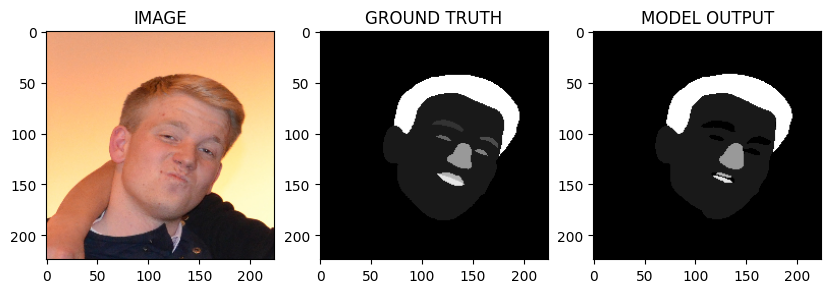

In [56]:
idx = 5
with torch.no_grad():
    image, mask = test[idx]
    logits_mask = model(image.to(DEVICE).unsqueeze(0))
    pred_mask = torch.sigmoid(logits_mask)
    pred_mask = (pred_mask > 0.5) * 1.0
    show_image(image,mask,pred_mask.detach().cpu().squeeze(0))

## Download shape_predictor

In [27]:
import dlib

In [28]:
!wget https://github.com/italojs/facial-landmarks-recognition/archive/refs/heads/master.zip -O 'shape'

--2023-12-13 03:15:46--  https://github.com/italojs/facial-landmarks-recognition/archive/refs/heads/master.zip
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/italojs/facial-landmarks-recognition/zip/refs/heads/master [following]
--2023-12-13 03:15:46--  https://codeload.github.com/italojs/facial-landmarks-recognition/zip/refs/heads/master
Resolving codeload.github.com (codeload.github.com)... 20.27.177.114
Connecting to codeload.github.com (codeload.github.com)|20.27.177.114|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘shape’

shape                   [                <=> ]  68.98M  5.87MB/s    in 12s     

2023-12-13 03:15:59 (5.87 MB/s) - ‘shape’ saved [72327196]



In [29]:
!unzip 'shape' -d 'shape_pred'

Archive:  shape
d37b6a7426e98094e28fa99254e270a3e9b6d591
   creating: shape_pred/facial-landmarks-recognition-master/
  inflating: shape_pred/facial-landmarks-recognition-master/README.md  
  inflating: shape_pred/facial-landmarks-recognition-master/main.py  
  inflating: shape_pred/facial-landmarks-recognition-master/shape_predictor_68_face_landmarks.dat  


In [30]:
predictor_path = '/content/shape_pred/facial-landmarks-recognition-master/shape_predictor_68_face_landmarks.dat'

In [31]:
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor(predictor_path)

## Function

In [61]:
total = list(range(0,68))
left_eye_indices = list(range(36, 42))
right_eye_indices = list(range(42, 48))
mouth_indices = list(range(48, 61))
smile_indices = list(range(48, 68))

#PARAM
#use BGR which is blue / green / red
left_eye_color = [125,125,0]
#use BGR which is blue / green / red
right_eye_color = [0,125,125]
#use HSV which is hue value
mouth_h = 200

#change/swap part of image
def add_part_image(full_img,part,mask):
    mask_inv = cv2.bitwise_not(mask)
    background = cv2.bitwise_and(full_img,full_img,mask = mask_inv)
    result = cv2.add(background,part)
    return result

#change mouth color base on mask
def change_mouth_color(bgr_img,mask,hue,logit_mouth,CURRENT_FACIAL):
    hsv_img = cv2.cvtColor(bgr_img,cv2.COLOR_BGR2HSV)
    my_mask = None
    if mask is not None:
        _,thresh = cv2.threshold(mask, 0 , 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        if (CURRENT_FACIAL is not None):
            CURRENT_FACIAL = cv2.bitwise_or(CURRENT_FACIAL,thresh)
        my_mask = cv2.bitwise_or(logit_mouth,mask)
    else:
        my_mask = logit_mouth
    h, s, v = cv2.split(hsv_img)
    h[my_mask == 255] = hue
    hsv_img = cv2.merge([h,s,v])

    img = cv2.cvtColor(hsv_img,cv2.COLOR_HSV2BGR)
    return img , CURRENT_FACIAL

#change iris eye base on mask
def change_iris_eye(bgr_img,mask,color,CURRENT_FACIAL):
    gray = cv2.cvtColor(bgr_img,cv2.COLOR_BGR2GRAY)
    gray = cv2.bitwise_and(gray,gray,mask = mask)
   # eye = cv2.bitwise_and(gray,gray,mask = mask)
    _,thresh = cv2.threshold(gray, 0 , 255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    thresh = cv2.bitwise_and(thresh,thresh,mask = mask)

    iris = bgr_img.copy()
    iris[:,:] = color

    iris = cv2.bitwise_and(iris,iris,mask = thresh)
    if (CURRENT_FACIAL is not  None):
        CURRENT_FACIAL = cv2.add(CURRENT_FACIAL,thresh)
    #iris = cv2.bitwise_and(iris,iris,mask = mask)

    result = add_part_image(bgr_img,iris,thresh)
    return result , CURRENT_FACIAL

#get face mask
def get_face(gray,landmarks):
    mask = np.zeros_like(gray)
    points = np.array([(landmarks.part(n).x,landmarks.part(n).y) for n in total])
    hull = cv2.convexHull(points)
    cv2.fillConvexPoly(mask, hull,255)
    return mask

#enhance face with mask
def enhance_face(hsv_img,result,mask):
    face_region = cv2.bitwise_and(hsv_img,hsv_img, mask = mask)
    face_region[:,:,2] = cv2.equalizeHist(face_region[:,:,2])
    face_region = cv2.cvtColor(face_region,cv2.COLOR_HSV2BGR)
    result = add_part_image(result,face_region,mask)
    return result

#get mouth mask
def get_mouth(logit,WIDTH,HEIGHT):
    mouth0 = (logit.numpy().astype(np.uint8))[7,:,:]
    mouth1 = (logit.numpy().astype(np.uint8))[8,:,:]
    mouth2 = (logit.numpy().astype(np.uint8))[9,:,:]

    _, mouth0 =  cv2.threshold(mouth0, 0 , 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU )
    _, mouth1 =  cv2.threshold(mouth1, 0 , 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU )
    _, mouth2 =  cv2.threshold(mouth2, 0 , 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU )

    mouth = mouth0
    mouth = cv2.bitwise_or(mouth,mouth1)
    mouth = cv2.bitwise_or(mouth,mouth2)

    kernel = np.ones((5,5),np.uint8)
    mouth = cv2.morphologyEx(mouth,cv2.MORPH_OPEN,kernel,iterations = 1)
    mouth = cv2.resize(mouth,(WIDTH,HEIGHT))

    return mouth


# combination of function to enhancement
def main(detector,predictor,frame,logit,logit_mouth,CURRENT_FACIAL,CURRENT_FACE):
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = detector(gray)
    result = frame.copy()
    hsv_img = cv2.cvtColor(result,cv2.COLOR_BGR2HSV)
    B,G,R = cv2.split(result)
    laplacian = np.array([
        [0,-1,0],
        [-1,5,-1],
        [0,-1,0]
    ])
    blur_kernel = (5,5)
    B = cv2.GaussianBlur(B,blur_kernel,0)
    G = cv2.GaussianBlur(G,blur_kernel,0)
    R = cv2.GaussianBlur(R,blur_kernel,0)

    R = cv2.medianBlur(R,3)
    G = cv2.medianBlur(G,3)
    B = cv2.medianBlur(B,3)

    B = cv2.filter2D(B.astype(np.int16),-1,laplacian).clip(0,255).astype(np.uint8)
    G = cv2.filter2D(G.astype(np.int16),-1,laplacian).clip(0,255).astype(np.uint8)
    R = cv2.filter2D(R.astype(np.int16),-1,laplacian).clip(0,255).astype(np.uint8)
    result = cv2.merge([B,G,R])
    for face in faces:
        landmarks = predictor(gray, face)
        mask = get_face(gray,landmarks)
        if (CURRENT_FACE is not None):
            CURRENT_FACE = cv2.bitwise_or(CURRENT_FACE,mask)
        result = enhance_face(hsv_img,result,cv2.bitwise_or(mask,logit))
        left_eye = np.array([((landmarks.part(idx).x) , (landmarks.part(idx).y)) for idx in left_eye_indices])
        right_eye = np.array([((landmarks.part(idx).x) , (landmarks.part(idx).y)) for idx in right_eye_indices])
        mouth = np.array([((landmarks.part(idx).x) , (landmarks.part(idx).y)) for idx in mouth_indices])
        mask1 = np.zeros(frame.shape[:2],dtype=np.uint8)
        mask2 = np.zeros(frame.shape[:2],dtype=np.uint8)
        mask3 = np.zeros(frame.shape[:2],dtype=np.uint8)
        cv2.drawContours(mask1,[left_eye],-1, (255, 255, 255), -1, cv2.LINE_AA)
        cv2.drawContours(mask2,[right_eye],-1, (255, 255, 255), -1, cv2.LINE_AA)
        cv2.drawContours(mask3,[mouth],-1, (255, 255, 255), -1, cv2.LINE_AA)

        result , CURRENT_FACIAL = change_mouth_color(result,mask3,mouth_h,logit_mouth,CURRENT_FACIAL)
        result , CURRENT_FACIAL = change_iris_eye(result,mask1,left_eye_color,CURRENT_FACIAL)
        result , CURRENT_FACIAL = change_iris_eye(result,mask2,right_eye_color,CURRENT_FACIAL)
    if (len(faces) == 0):
        result = enhance_face(hsv_img,result,logit)
        result , CURRENT_FACIAL = change_mouth_color(result,None,mouth_h,logit_mouth,CURRENT_FACIAL)
    return result , CURRENT_FACIAL , CURRENT_FACE

#
def enhancer(image):
    HEIGHT,WIDTH = image.shape[:2]


    #initial combine result mask from method
    # get mask from model
    my_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    my_img = cv2.resize(my_img,(224,224))
    my_img = np.transpose(my_img, (2,0,1)).astype(np.float32)
    my_img = torch.Tensor(my_img) / 255.0
    logit = model(my_img.to(DEVICE).unsqueeze(0))
    my_logit = logit.detach().cpu().squeeze(0)
    my_logit = torch.sigmoid(my_logit)
    my_logit = (my_logit > 0.5) * 255.0

    #get face
    mouth = get_mouth(my_logit,WIDTH,HEIGHT)
    nhair = (my_logit.numpy().astype(np.uint8))[10,:,:]
    face = (my_logit.numpy().astype(np.uint8))[0,:,:]
    _, nhair =  cv2.threshold(nhair, 0 , 255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU )
    _, face =  cv2.threshold(face, 0 , 255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU )
    mask_face = cv2.bitwise_and(nhair,face)
    kernel = np.ones((5,5),np.uint8)
    #remove noise
    mask_face = cv2.morphologyEx(mask_face,cv2.MORPH_OPEN,kernel,iterations = 1)
    mask_face = cv2.resize(mask_face,(WIDTH,HEIGHT))
    # result = main(detector,predictor,image)(detector,predictor,frame,logit,logit_mouth,CURRENT_FACIAL,CURRENT_FACE)
    result , CURRENT_FACIAL , CURRENT_FACE = main(detector,predictor,image,mask_face,mouth,None, None)
    result = cv2.cvtColor(result,cv2.COLOR_BGR2RGB)

    return result

## Use Case

In [33]:
def my_iou(predict,mask):
    predict = predict // 255
    mask = mask // 255
    intersection = np.sum(predict & mask)
    union = np.sum(predict | mask)
    return (intersection + 1e-10) / (union + 1e-10)

### Eval

facial enhance = 0.8440637920850592 , face enhance = 0.947230723664725


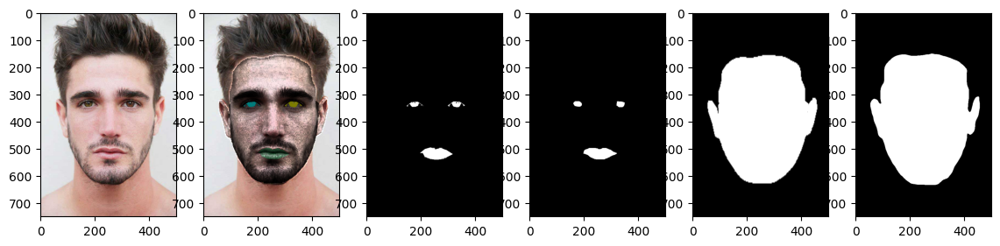

facial enhance = 0.7480635955972313 , face enhance = 0.9314907025149783


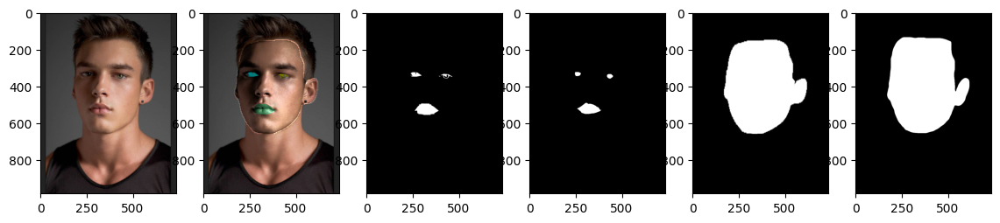

facial enhance = 0.6677190213101902 , face enhance = 0.9112035503407468


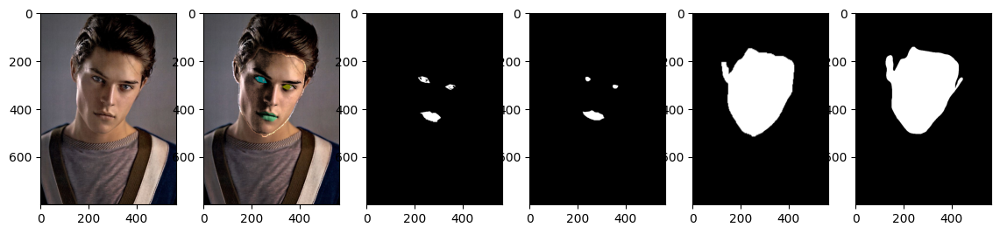

facial enhance = 0.7651999498558385 , face enhance = 0.9534845115830032


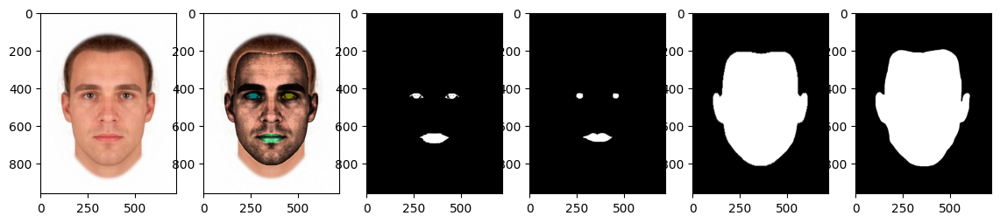

facial enhance = 0.7577759250945952 , face enhance = 0.8989951635846373


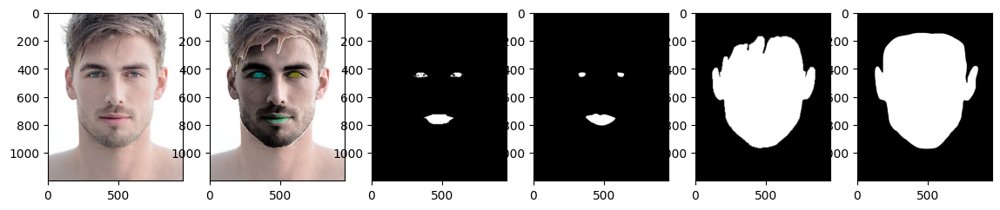

facial enhance = 0.5948795180722952 , face enhance = 0.8638769895169436


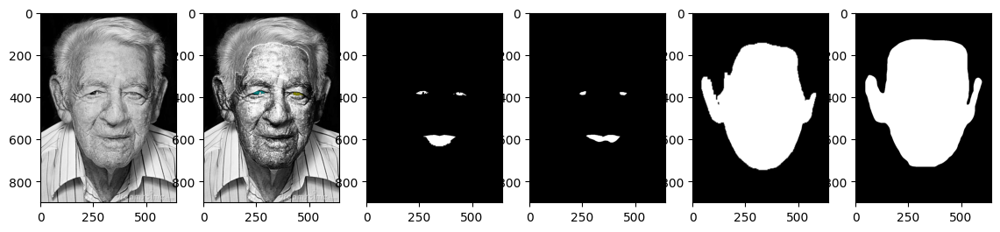

facial enhance = 0.6782015991611 , face enhance = 0.8705861561790964


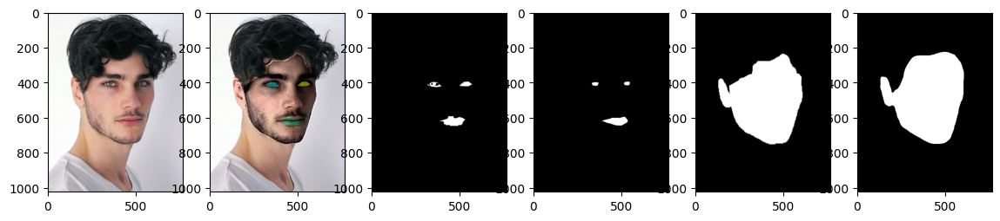

facial enhance = 0.5589984088434823 , face enhance = 0.8393570350136662


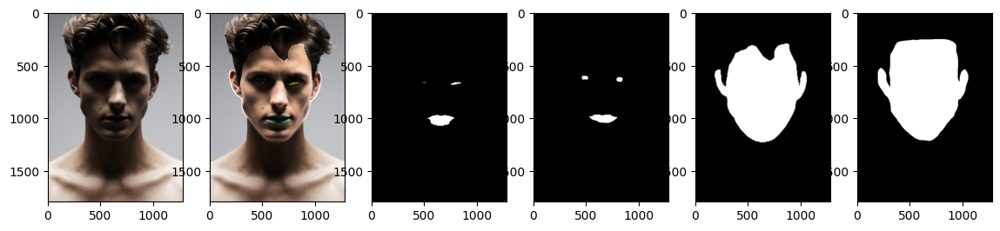

facial enhance = 0.7648704932968907 , face enhance = 0.8986314922430049


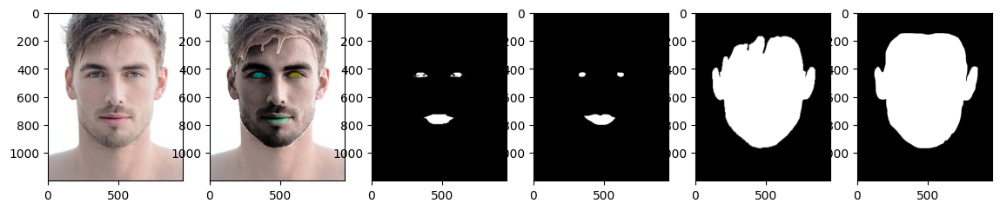

facial enhance = 0.6354927007299298 , face enhance = 0.8842828591318408


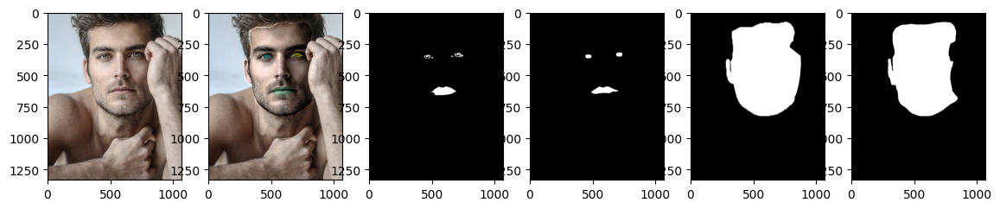

facial enhance = 0.6210902003921759 , face enhance = 0.9453237922132933


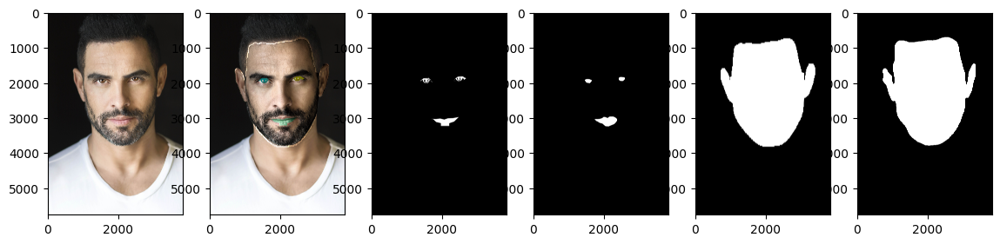

facial enhance = 0.676845477472566 , face enhance = 0.9375134336283932


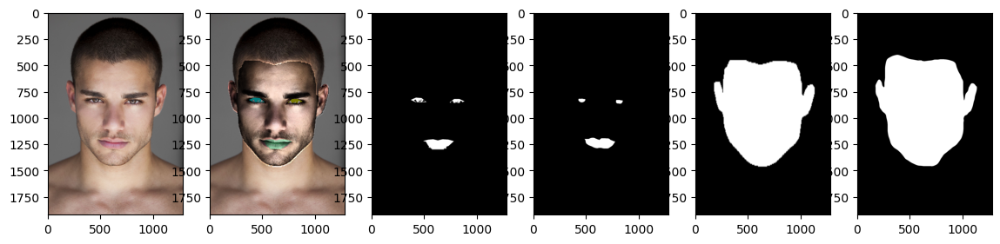

facial enhance = 1.2631047113805575e-14 , face enhance = 0.7499898433373856


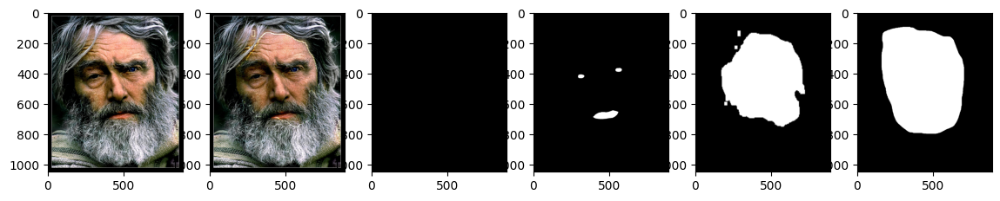

facial enhance = 0.7355584082156653 , face enhance = 0.9195721406812518


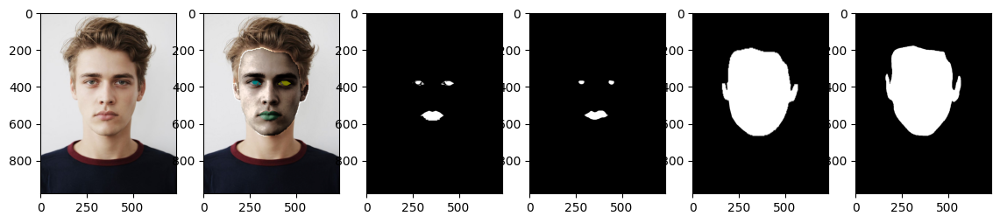

facial enhance = 0.6621070314374932 , face enhance = 0.9423266984771358


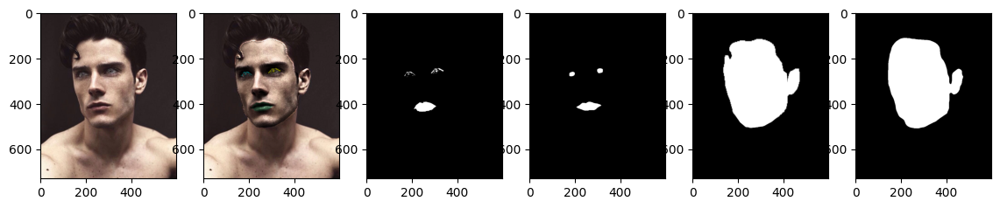

facial enhance = 0.7185757957201993 , face enhance = 0.9427106628126648


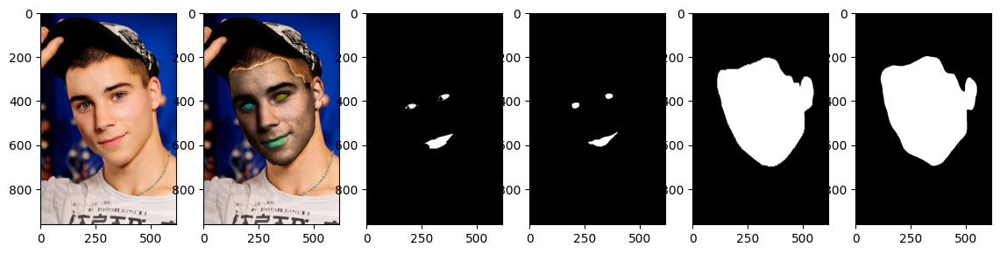

facial enhance = 0.7366023579849982 , face enhance = 0.9472545047956981


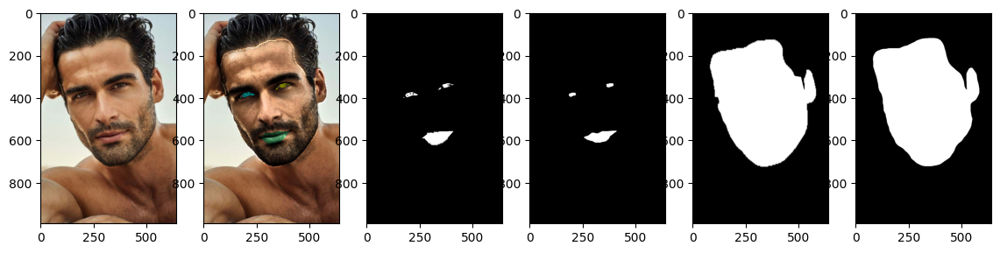

facial enhance = 0.7376796714579122 , face enhance = 0.9076007100450998


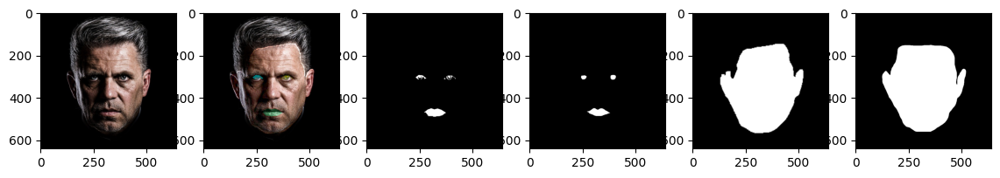

facial enhance = 0.5661764705882708 , face enhance = 0.935667197090248


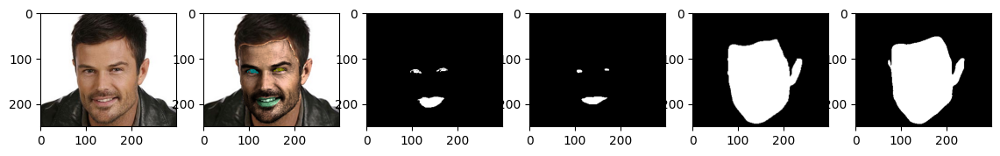

facial enhance = 1.019575856443709e-14 , face enhance = 0.8297660728869339


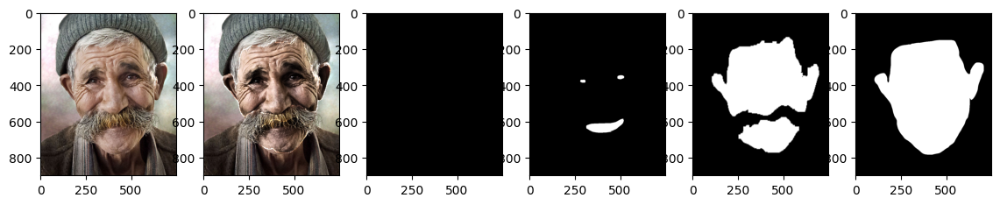

facial enhance = 0.7835978092964502 , face enhance = 0.9113282023711837


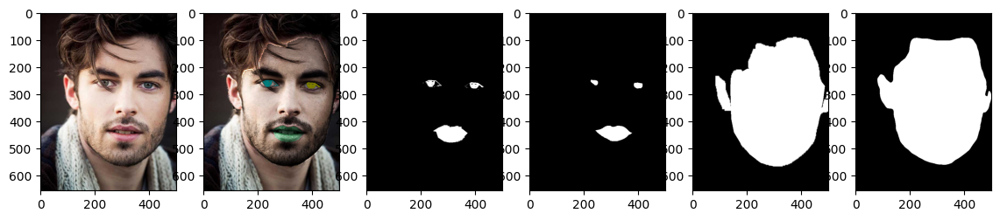

facial enhance = 0.09930643127367278 , face enhance = 0.8182109633397632


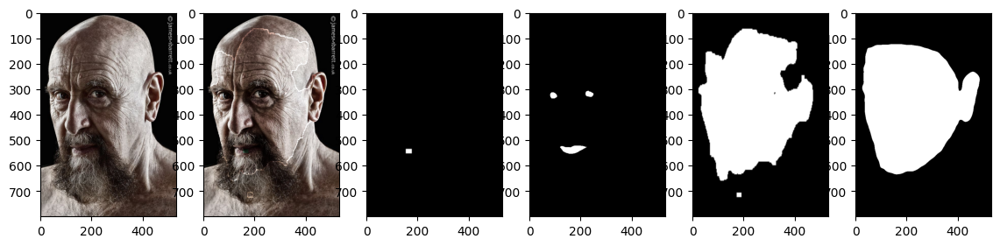

facial enhance = 0.6271259418729898 , face enhance = 0.8600887005761579


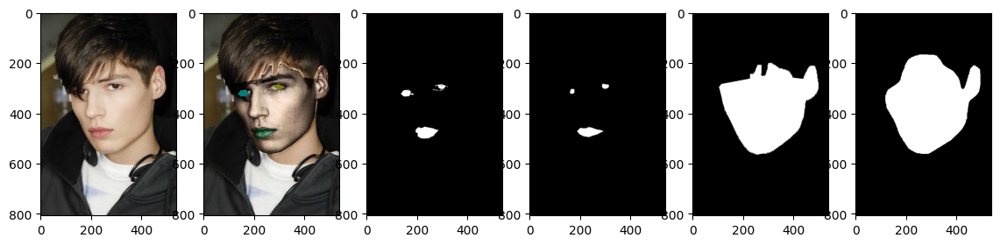

facial enhance = 0.7760436687937282 , face enhance = 0.9636436191059836


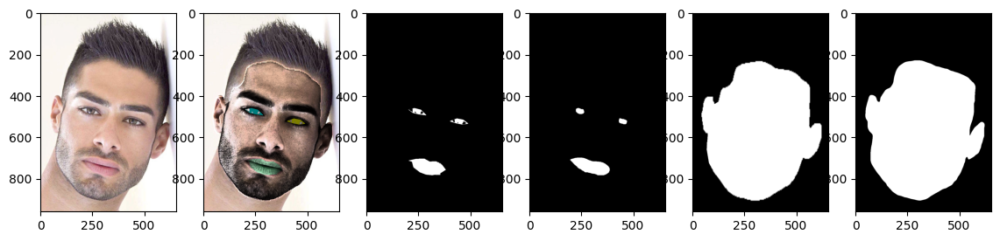

facial enhance = 0.7754684838160174 , face enhance = 0.9397744188709493


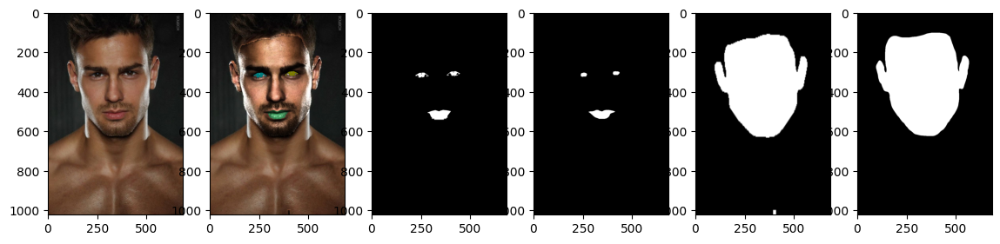

facial enhance = 0.7475746806262631 , face enhance = 0.9622005725937673


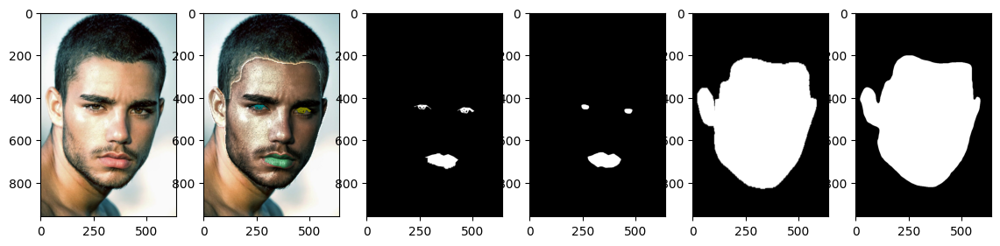

facial enhance = 8.614006374364643e-15 , face enhance = 0.6890519187358918


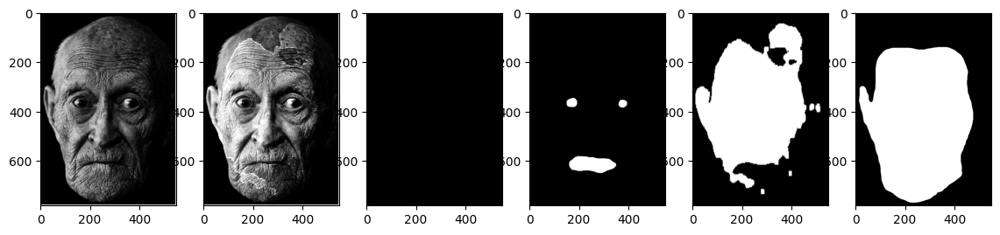

facial enhance = 0.7095635929635219 , face enhance = 0.9304455167027396


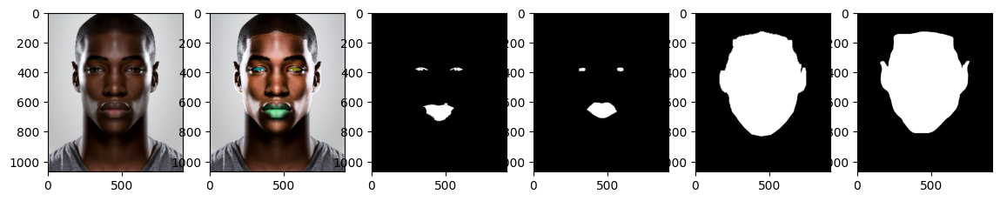

facial enhance = 0.7448053258018988 , face enhance = 0.8112357059725481


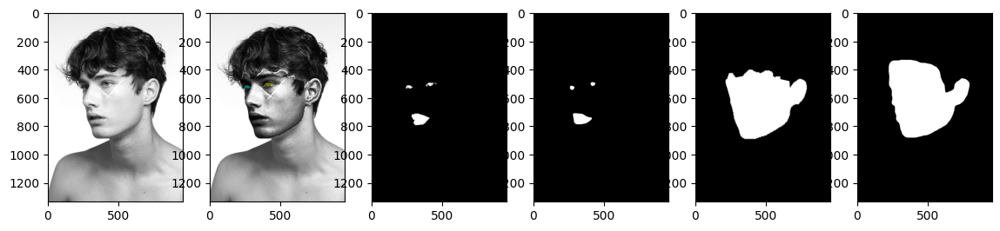

facial enhance = 0.7778041261560403 , face enhance = 0.9445919858360264


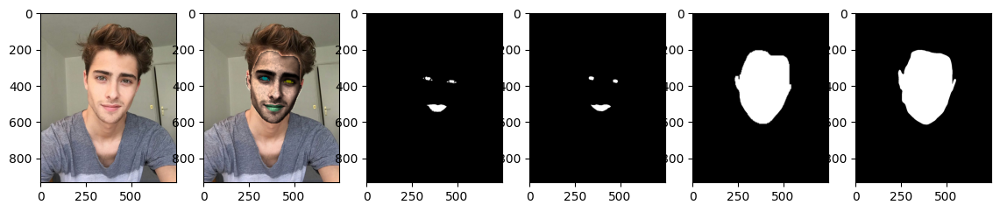

facial enhance = 0.8032975980458692 , face enhance = 0.7772958439959833


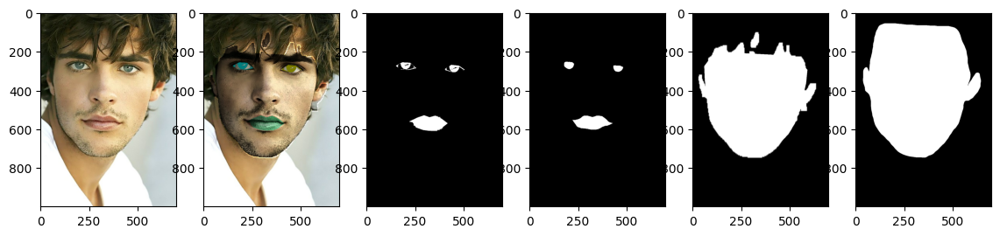

facial enhance = 0.7608299331539217 , face enhance = 0.9432003176493945


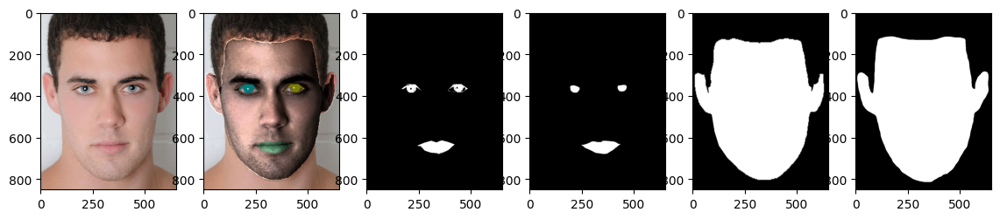

facial enhance = 0.7490257209664946 , face enhance = 0.9655244990739182


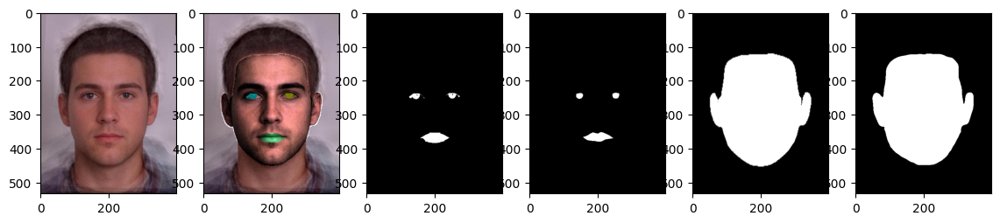

facial enhance = 4.072822058404252e-15 , face enhance = 0.7985928836632608


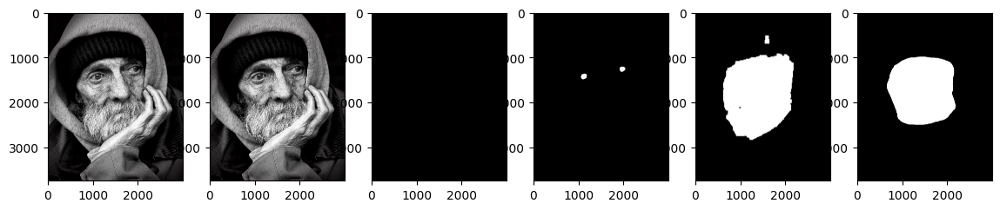

facial enhance = 0.773622807695281 , face enhance = 0.9423565451285115


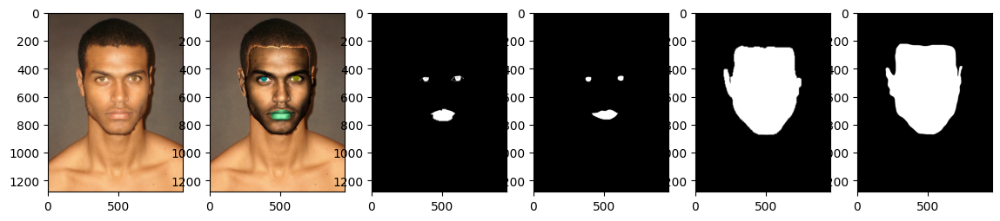

facial enhance = 0.5878907036896774 , face enhance = 0.9326177590432204


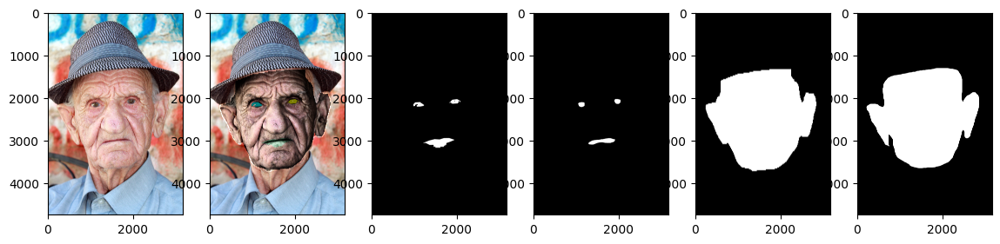

facial enhance = 0.8412312677197268 , face enhance = 0.9611281240738911


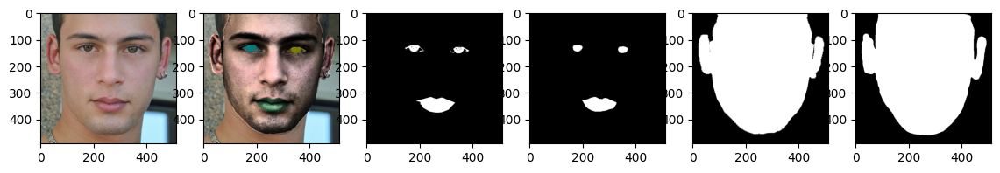

facial enhance = 0.7822391559202877 , face enhance = 0.9522283254997452


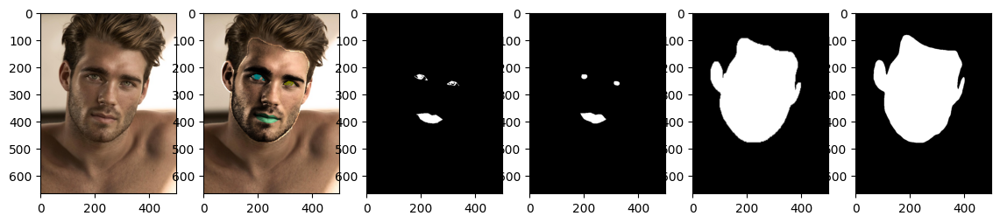

facial enhance = 0.7922894424673809 , face enhance = 0.9422670629520877


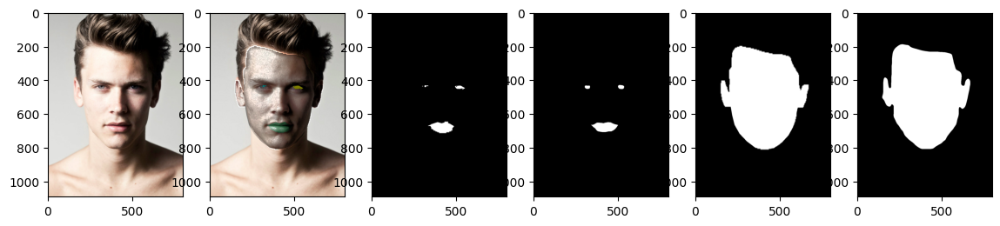

facial enhance = 0.6687077805316622 , face enhance = 0.7816890588606101


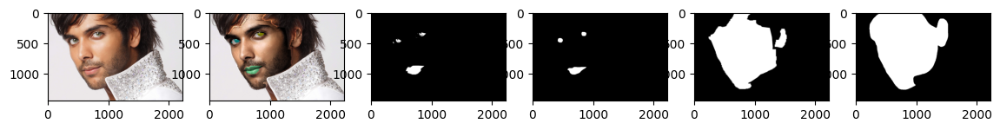

facial enhance = 0.5204655291448909 , face enhance = 0.8310137702022757


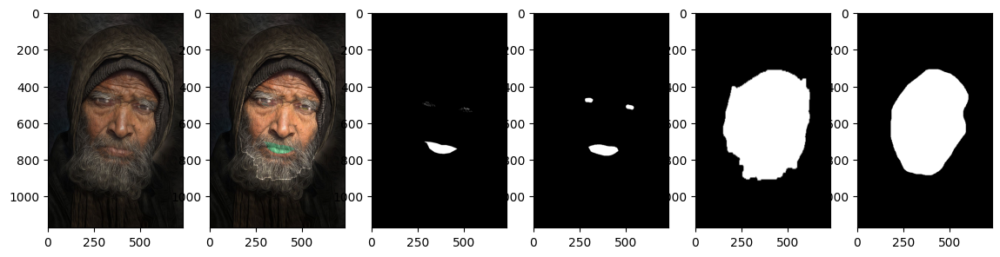

facial enhance = 0.6897163120567925 , face enhance = 0.7126397542032968


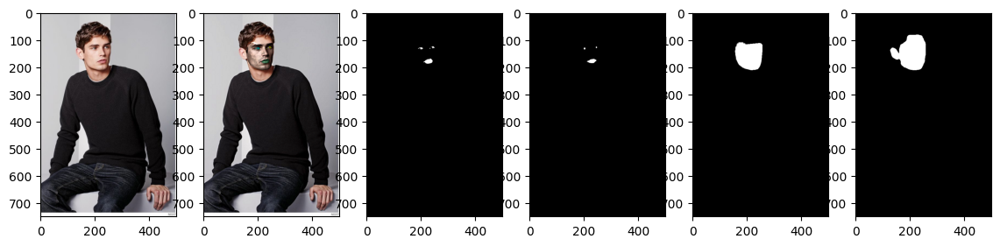

facial enhance = 0.730103806228387 , face enhance = 0.9032779355980065


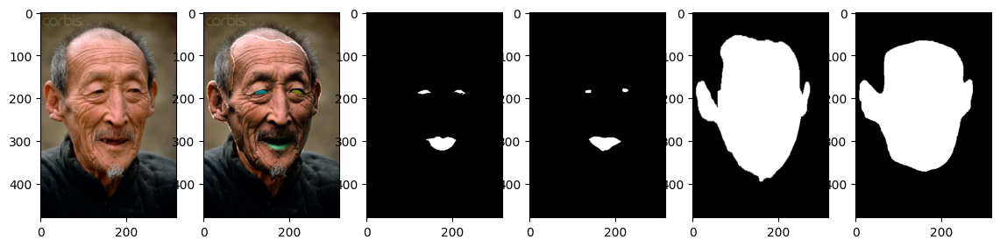

facial enhance = 0.7595540331788585 , face enhance = 0.9422241418735232


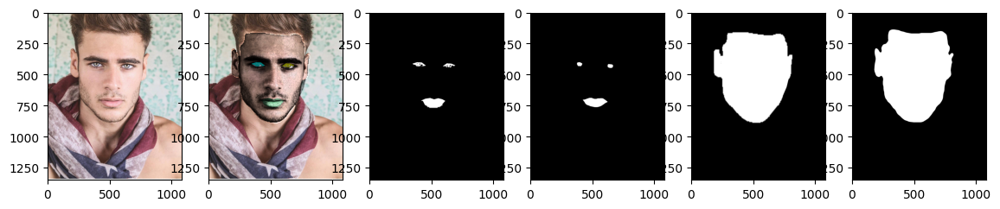

facial enhance = 0.744646870933398 , face enhance = 0.9422397038408145


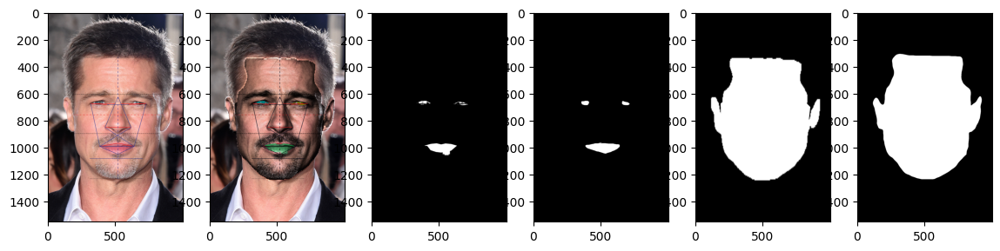

facial enhance = 0.7075570841692967 , face enhance = 0.8940176850873376


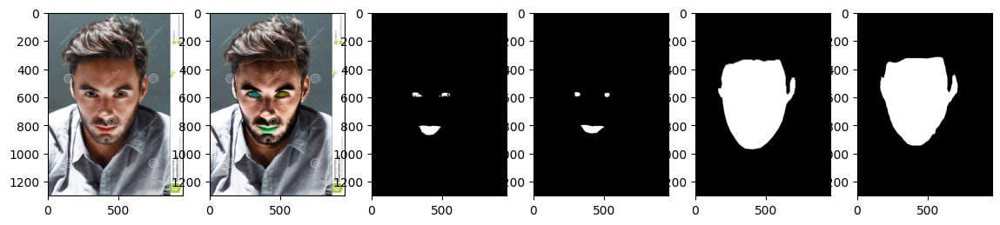

facial enhance = 0.783870072182124 , face enhance = 0.9559351926190132


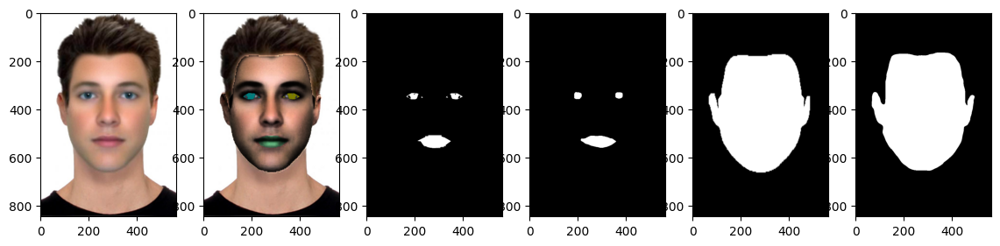

facial enhance = 0.5876913265306254 , face enhance = 0.9276085392180381


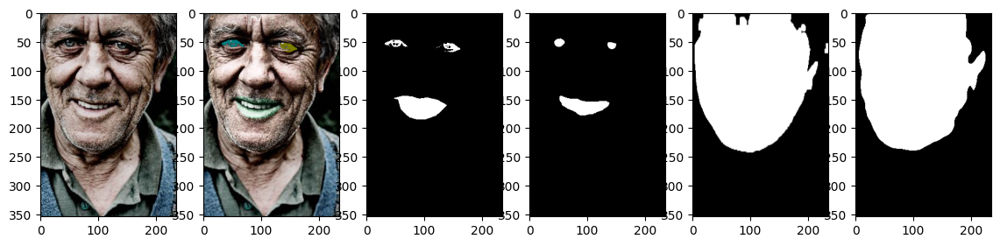

facial enhance = 0.7366941152841989 , face enhance = 0.9165922562100842


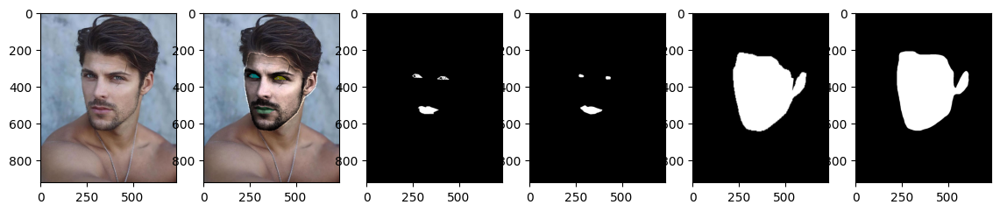

facial enhance = 0.3897189161813272 , face enhance = 0.8625944349671003


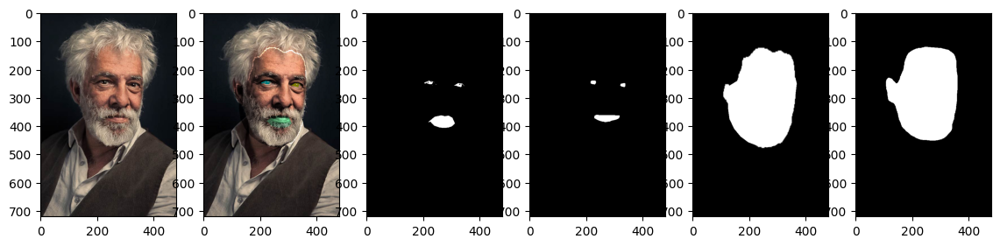

facial enhance = 0.7291330970029047 , face enhance = 0.9573466720602422


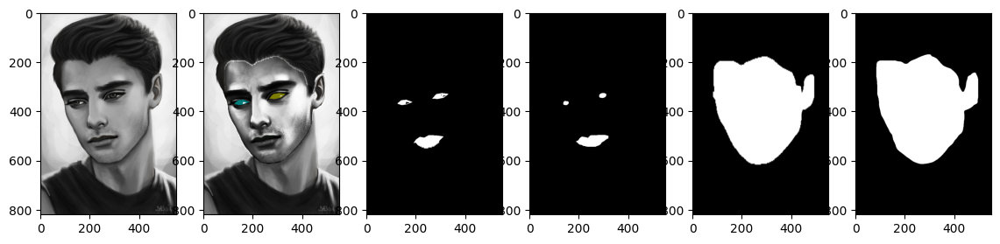

facial enhance = 0.36221262150903133 , face enhance = 0.8691526192898602


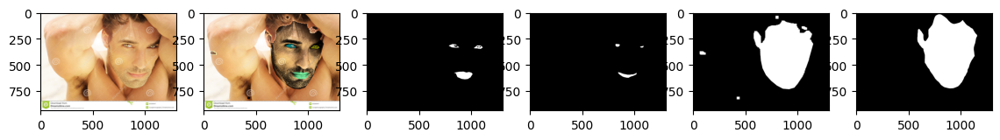

facial enhance = 0.20056435858477967 , face enhance = 0.9528280712254976


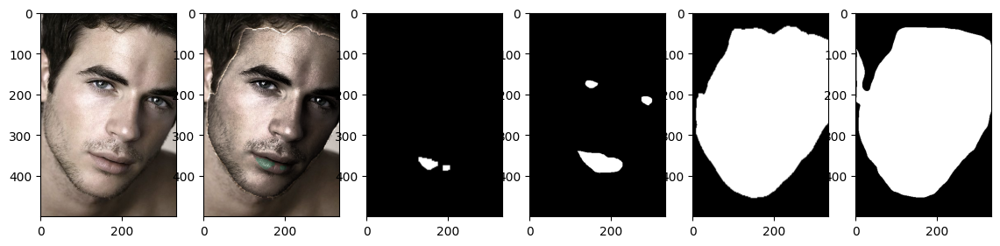

facial enhance = 0.8410815284866889 , face enhance = 0.9444689055869787


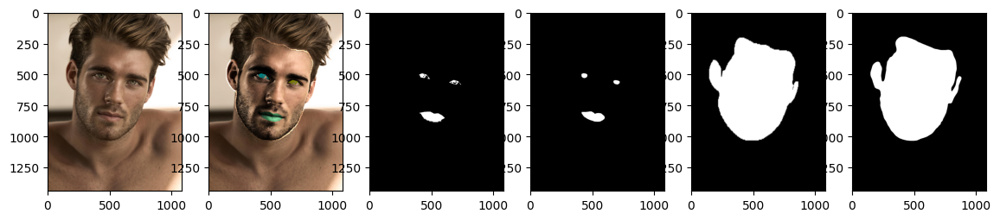

facial enhance = 0.5772204088644599 , face enhance = 0.9359123729515108


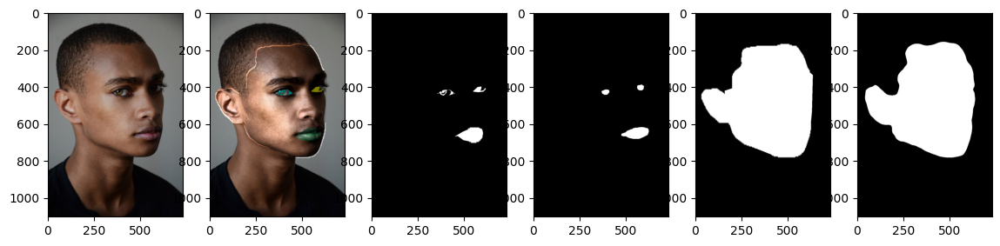

facial enhance = 0.6564523090202923 , face enhance = 0.9250499327436514


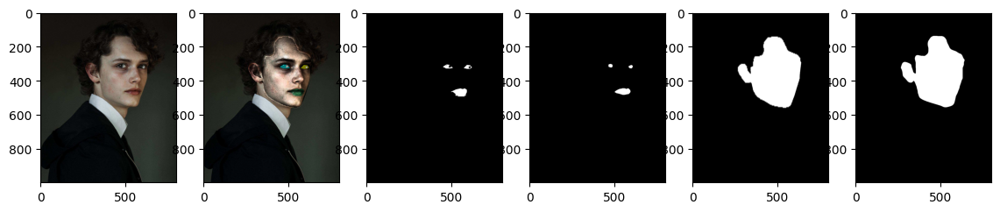

facial enhance = 6.071645415907342e-14 , face enhance = 0.5658677743809956


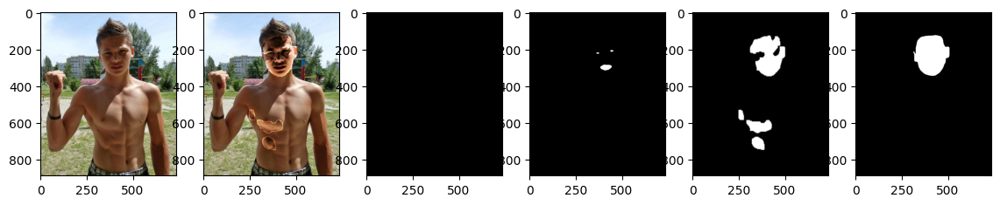

facial enhance = 0.5459678225242354 , face enhance = 0.7948244504556072


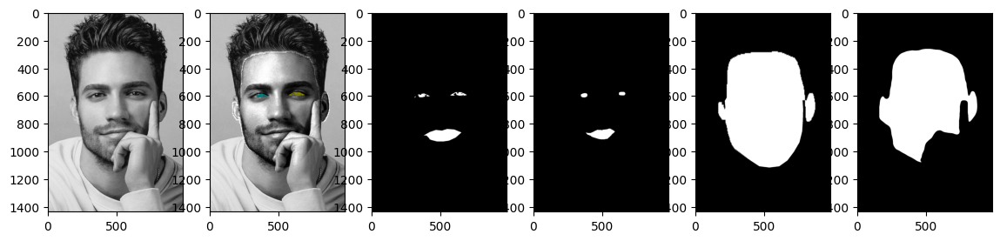

facial enhance = 0.5786205367043784 , face enhance = 0.8922402814651731


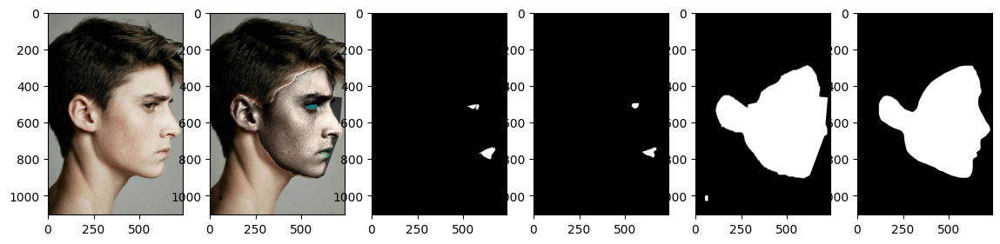

facial enhance = 0.619473007712083 , face enhance = 0.9279362272920232


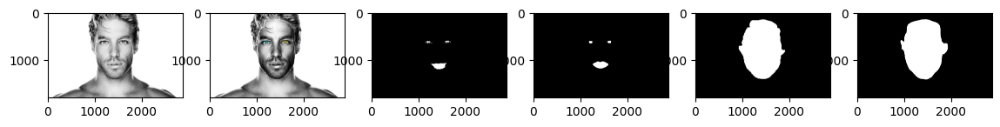

facial enhance = 0.15259210955333705 , face enhance = 0.7606256629367916


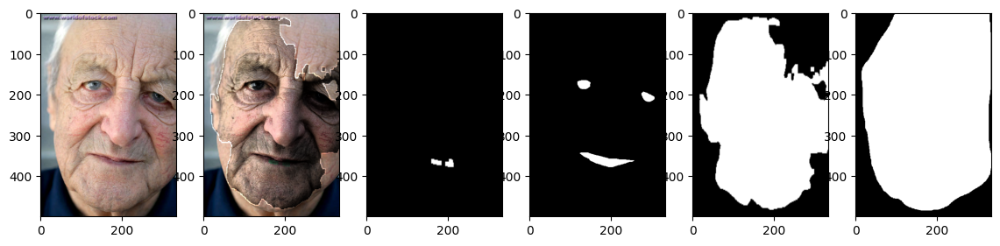

facial enhance = 0.6527738301335891 , face enhance = 0.9302937219014185


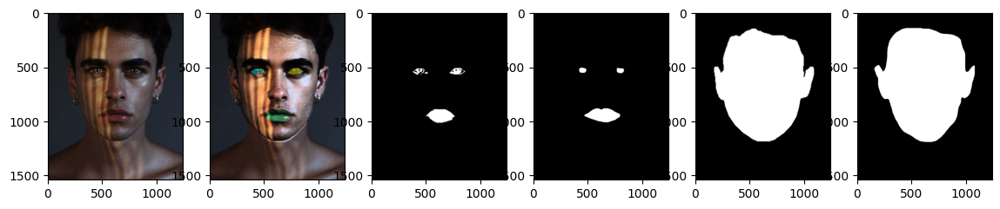

facial enhance = 0.5206399367963752 , face enhance = 0.8294553567871232


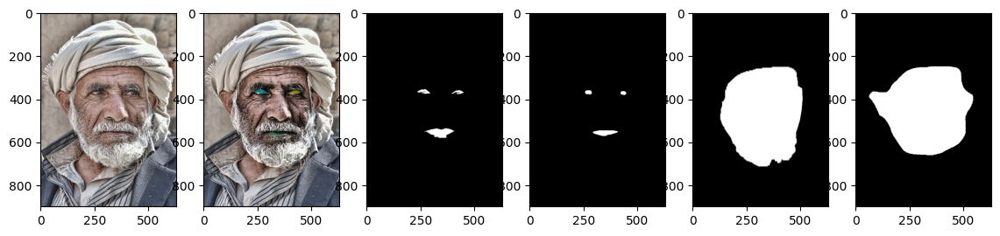

facial enhance = 0.7181077937185065 , face enhance = 0.8964454172704013


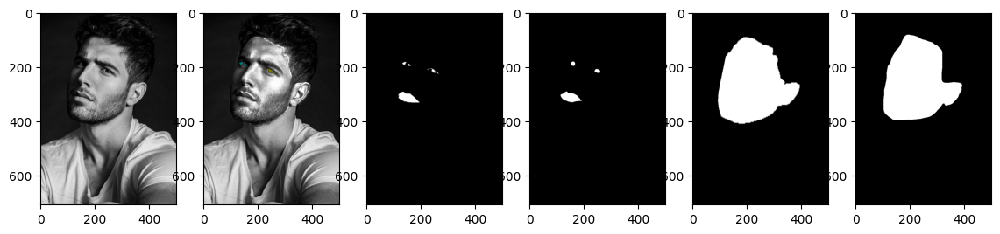

facial enhance = 0.7143838939197942 , face enhance = 0.9433552313927459


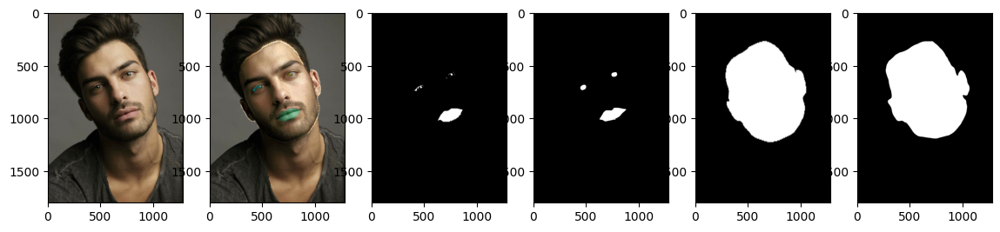

facial enhance = 0.7003113648157836 , face enhance = 0.9282895158557916


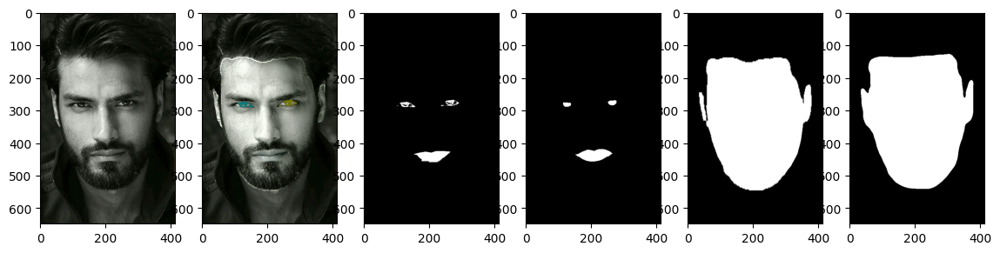

facial enhance = 0.7835067203280448 , face enhance = 0.9535934145865489


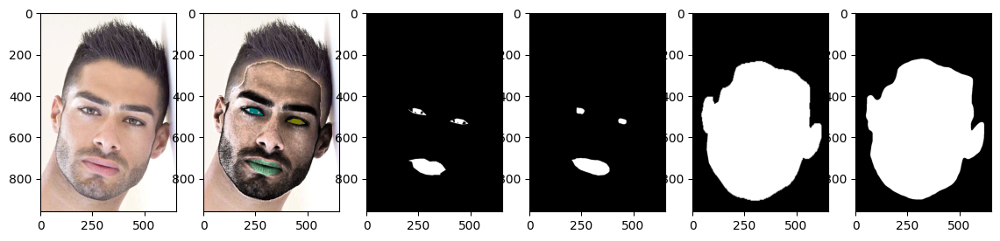

facial enhance = 0.37203849347858253 , face enhance = 0.7578508052233893


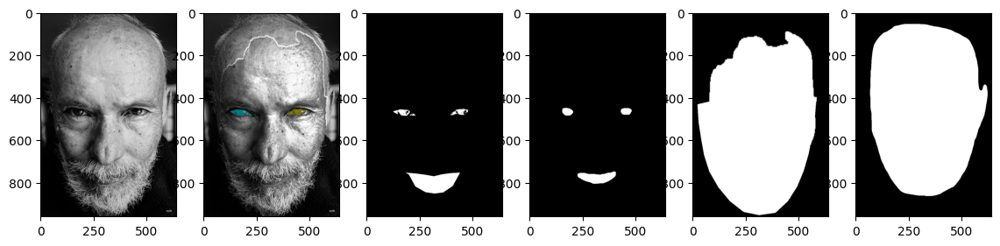

facial enhance = 0.5953158428104989 , face enhance = 0.9317715512586786


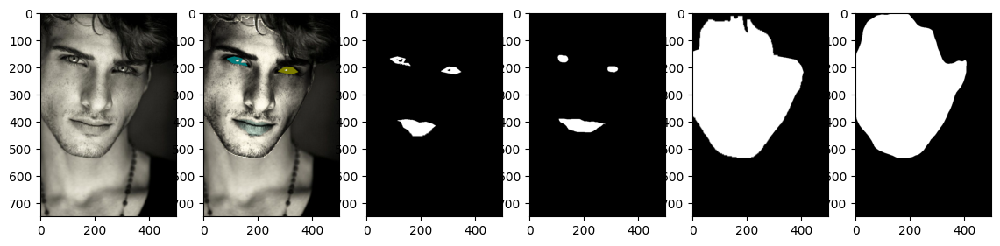

facial enhance = 0.49820671666124067 , face enhance = 0.9404704068611257


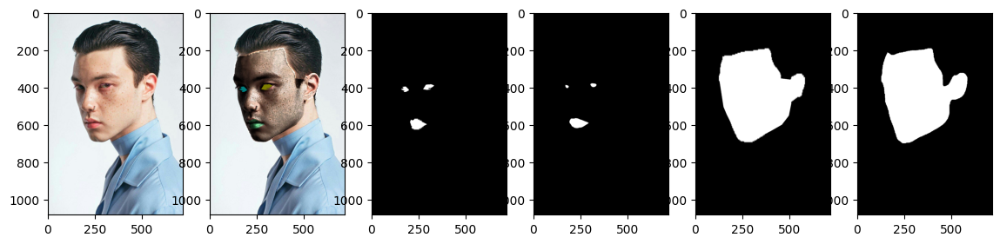

facial enhance = 0.6476261127596527 , face enhance = 0.9452670491273433


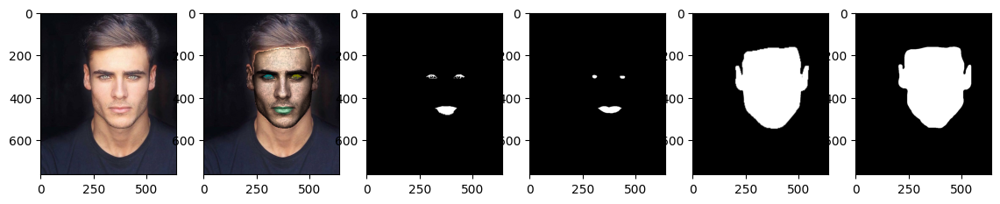

facial enhance = 0.646277232463492 , face enhance = 0.9563767279387899


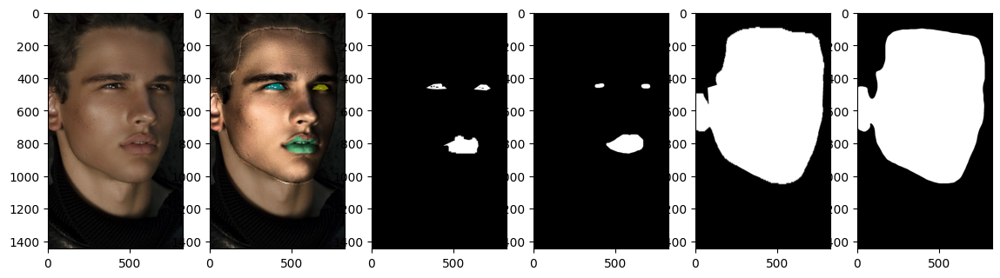

facial enhance = 0.6825910931174346 , face enhance = 0.9213576733532314


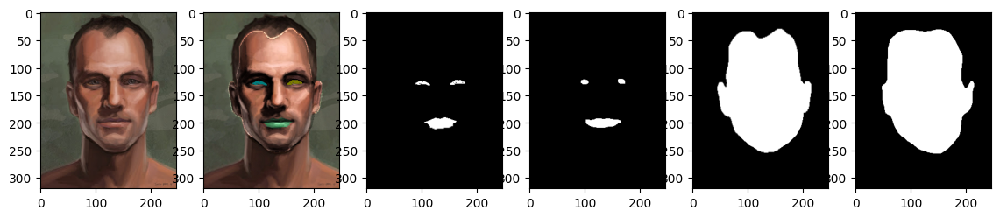

facial enhance = 0.8012685755708597 , face enhance = 0.966841477517367


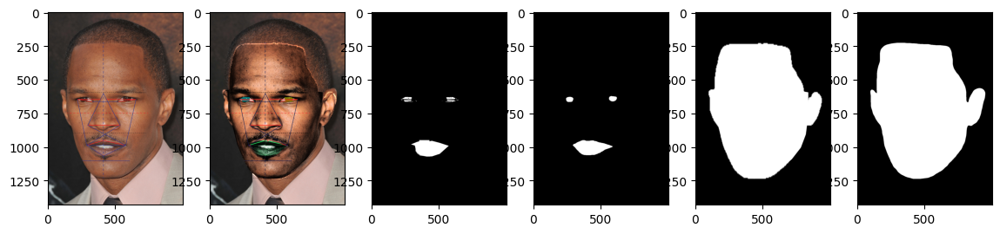

facial enhance = 0.6303002309468856 , face enhance = 0.907123497469171


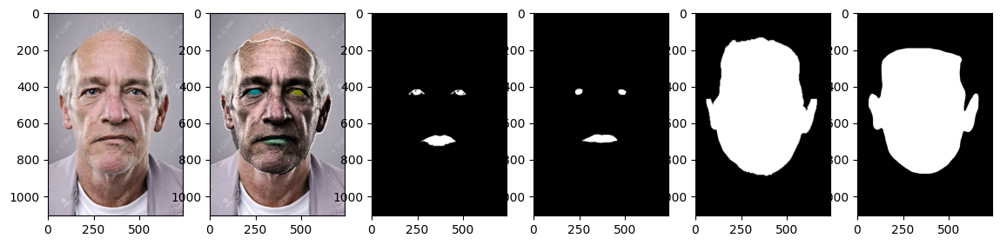

facial enhance = 0.5771159874608217 , face enhance = 0.9600000000000001


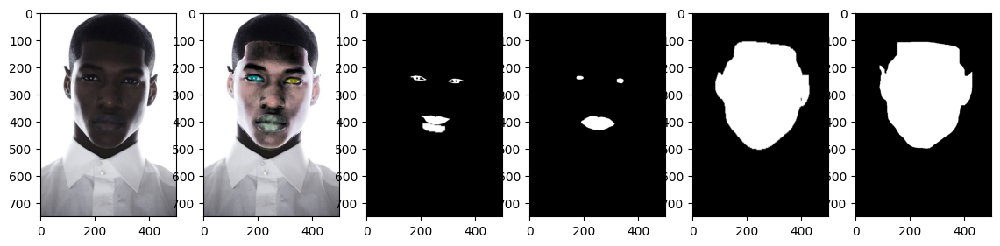

facial enhance = 0.7326748196926979 , face enhance = 0.9586207660196433


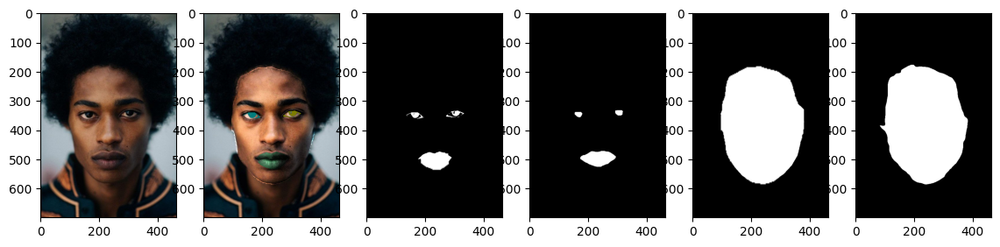

facial enhance = 0.5845110590024742 , face enhance = 0.8879281155084322


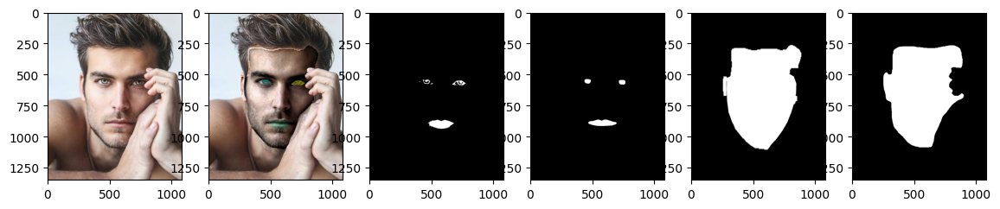

facial enhance = 0.6756900212314397 , face enhance = 0.9565812679847768


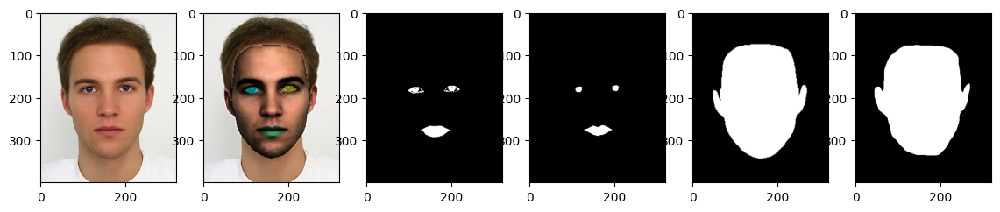

facial enhance = 0.7271885132005583 , face enhance = 0.9511438855709992


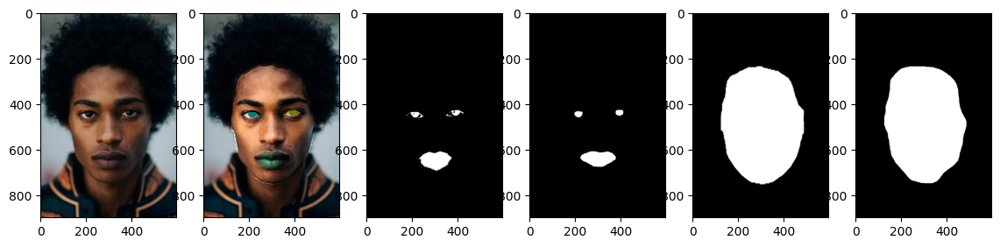

facial enhance = 0.7189542483660147 , face enhance = 0.9443529547724591


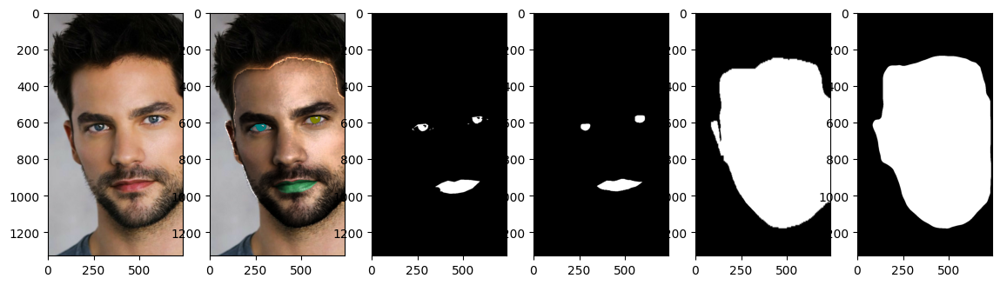

facial enhance = 1.0373443983402382e-14 , face enhance = 0.4753108491254932


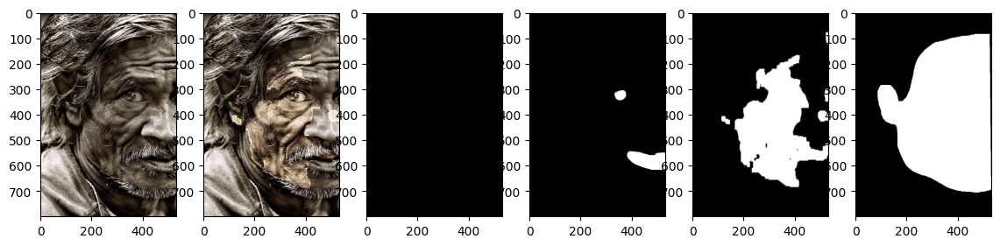

facial enhance = 0.21634699810735553 , face enhance = 0.8621244057205526


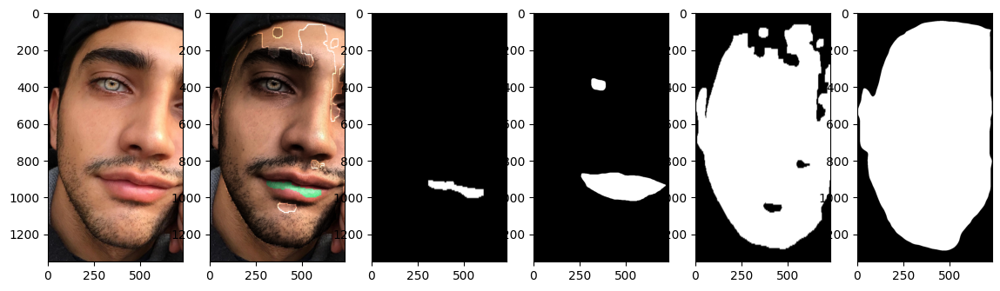

facial enhance = 0.7857779006203554 , face enhance = 0.9594924115087997


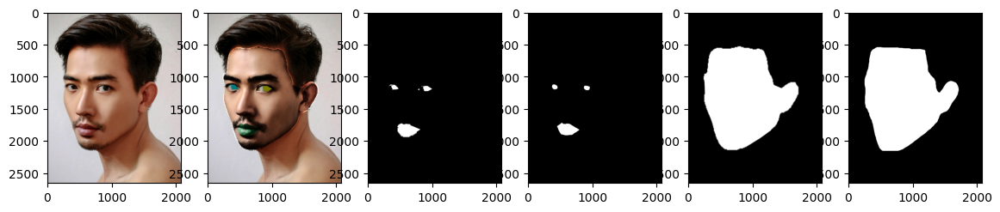

facial enhance = 0.5553637742559782 , face enhance = 0.9357720600876599


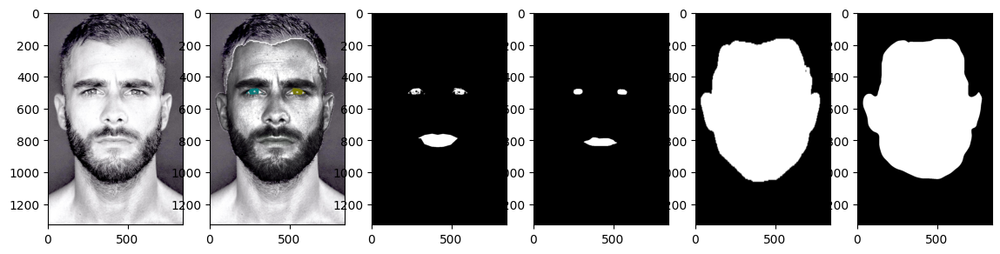

facial enhance = 0.7562866326337728 , face enhance = 0.9408611208969627


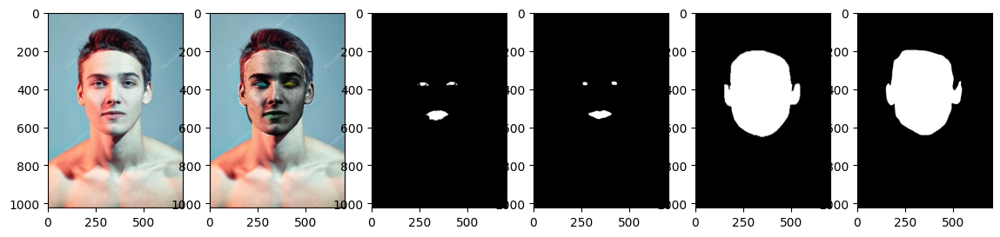

facial enhance = 0.7210552848260808 , face enhance = 0.9267808180399072


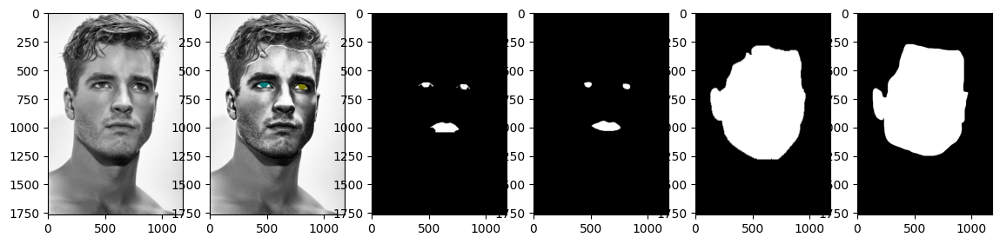

facial enhance = 5.128205128202499e-13 , face enhance = 0.7687961872121671


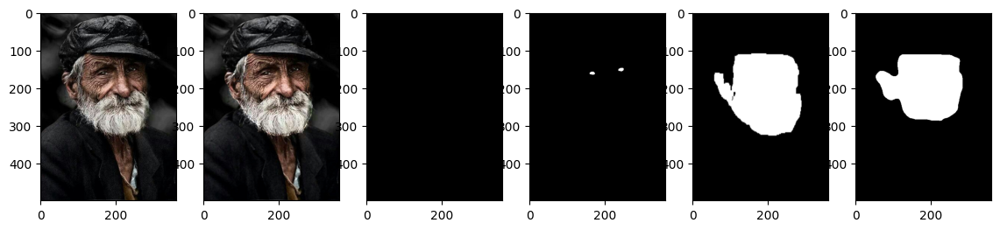

facial enhance = 0.6321270137753928 , face enhance = 0.942382372218665


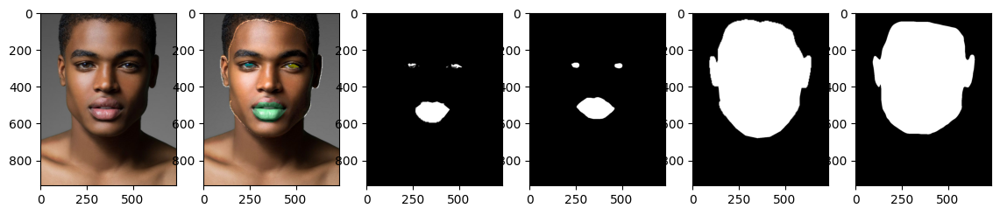

facial enhance = 0.6609242830616912 , face enhance = 0.9315008223962529


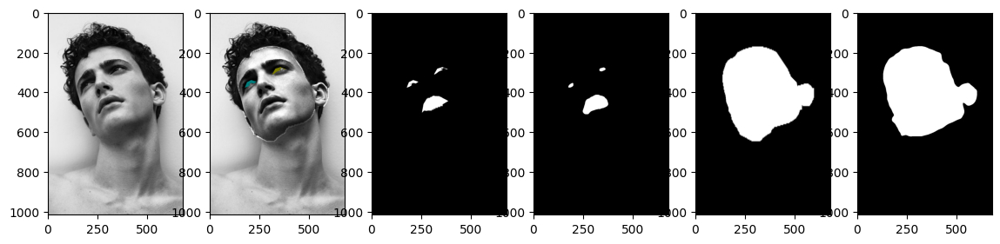

facial enhance = 0.5354676710609205 , face enhance = 0.9203840237627965


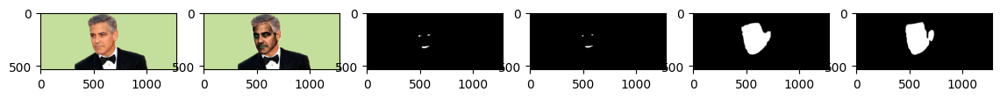

facial enhance = 0.3812745869394275 , face enhance = 0.8740624054581305


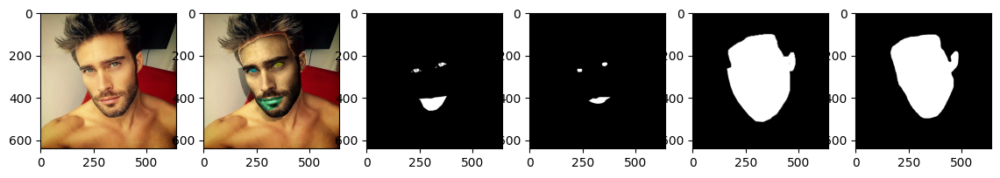

facial enhance = 0.7260500235960423 , face enhance = 0.9606204481491826


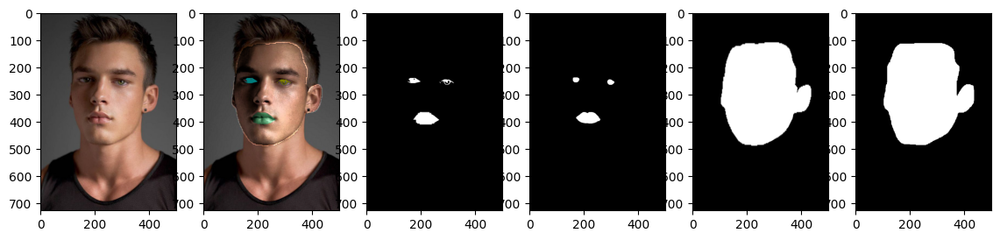

facial enhance = 0.6793910474892106 , face enhance = 0.9458439762847702


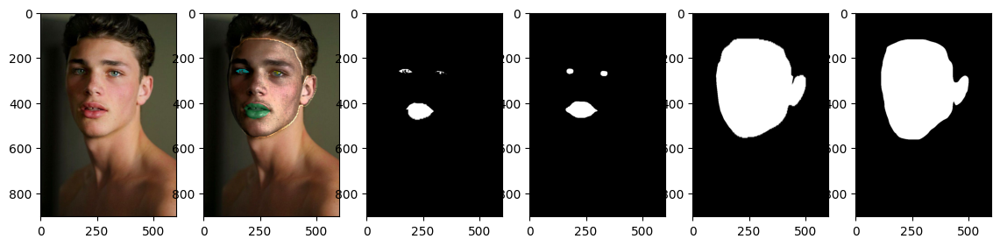

facial enhance = 4.629629629627487e-13 , face enhance = 0.8382391247720764


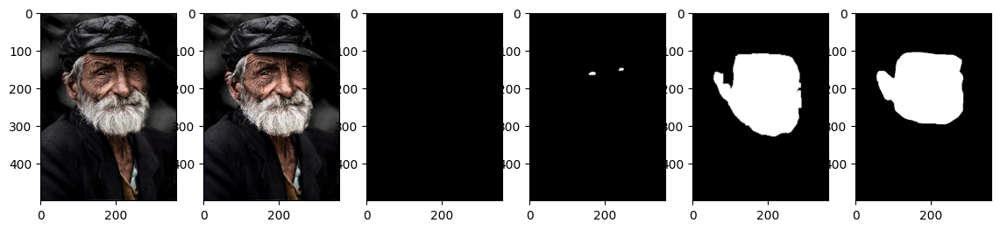

facial enhance = 0.7402065235207386 , face enhance = 0.9010402024177679


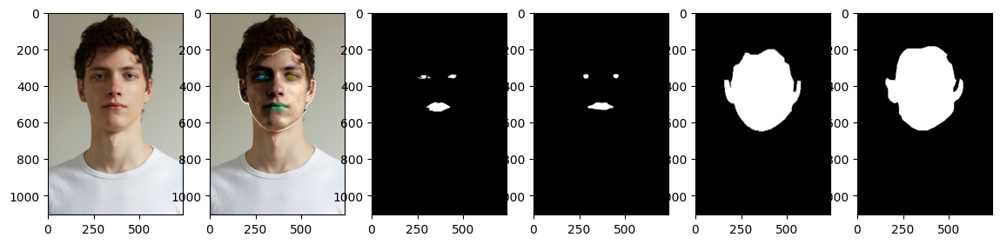

facial enhance = 0.7657620893695212 , face enhance = 0.8473941342656909


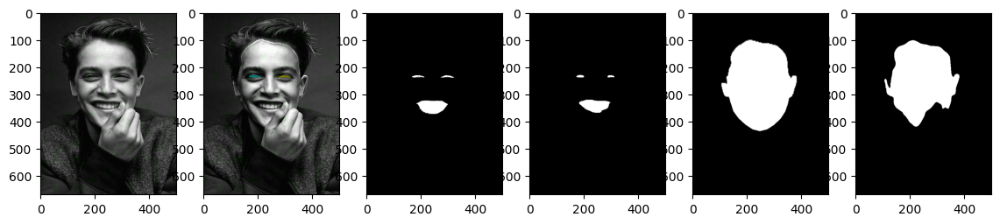

facial enhance = 0.7150139017608963 , face enhance = 0.9448778886971619


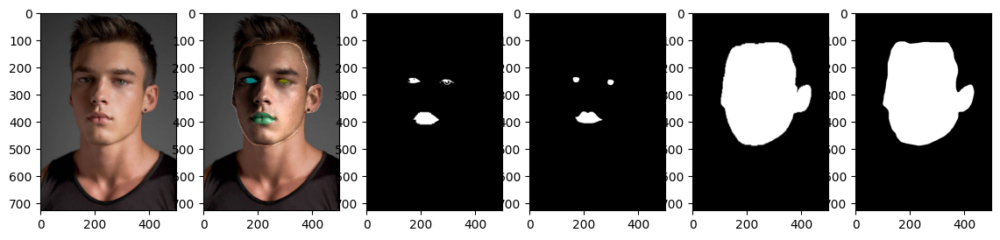

facial enhance = 8.518903446748328e-16 , face enhance = 0.8577680149645621


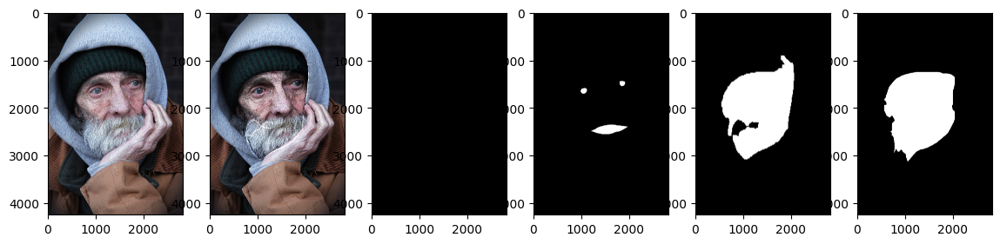

facial enhance = 0.6148148148148623 , face enhance = 0.9397003401047892


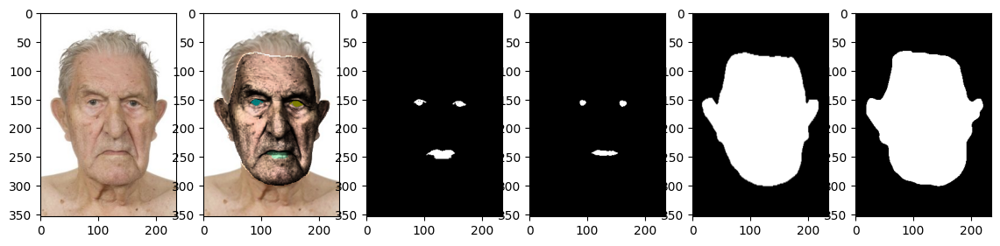

average iou = 0.8953880309047704
average iou = 0.5964900578626695


In [34]:
path_img = '/content/archive'
path_markup = '/content/markup'
path_face_m = '/content/face-m'
score = np.zeros(100,dtype = np.float64)
fscore = np.zeros(100,dtype = np.float64)
psnr = np.zeros(100,dtype = np.float64)
c = 10
K = 0.0001
model.eval()
with torch.no_grad():
    for i in range(0,100):
        p = os.path.join(path_img,f'1 ({i + 1}).jpg')
        image = cv2.imread(p)
        HEIGHT,WIDTH = image.shape[:2]
        my_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        my_img = cv2.resize(my_img,(224,224))
        my_img = np.transpose(my_img, (2,0,1)).astype(np.float32)
        my_img = torch.Tensor(my_img) / 255.0
        logit = model(my_img.to(DEVICE).unsqueeze(0))

        CURRENT_FACIAL = np.zeros((HEIGHT,WIDTH),dtype = np.uint8)
        CURRENT_FACE = np.zeros((HEIGHT,WIDTH),dtype = np.uint8)

        my_logit = logit.detach().cpu().squeeze(0)
        my_logit = torch.sigmoid(my_logit)
        my_logit = (my_logit > 0.5) * 255.0

        mouth = get_mouth(my_logit,WIDTH,HEIGHT)
        nhair = (my_logit.numpy().astype(np.uint8))[10,:,:]
        face = (my_logit.numpy().astype(np.uint8))[0,:,:]
        _, nhair =  cv2.threshold(nhair, 0 , 255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU )
        _, face =  cv2.threshold(face, 0 , 255,cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU )
        mask_face = cv2.bitwise_and(nhair,face)
        kernel = np.ones((5,5),np.uint8)
        mask_face = cv2.morphologyEx(mask_face,cv2.MORPH_OPEN,kernel,iterations = 1)
        mask_face = cv2.resize(mask_face,(WIDTH,HEIGHT))

        p_markup = os.path.join(path_markup,f'1 ({i + 1}).jpg')
        markup = cv2.imread(p_markup,0)
        _, thresh =  cv2.threshold(markup, 0 , 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU )

        f_markup = os.path.join(path_face_m,f'1 ({i + 1}).jpg')
        fmarkup = cv2.imread(f_markup,0)
        _, fthresh =  cv2.threshold(fmarkup, 0 , 255,cv2.THRESH_BINARY + cv2.THRESH_OTSU )
        CURRENT_FACE = mask_face
        CURRENT_FACIAL = mouth
    # result = main(detector,predictor,image)
        result , CURRENT_FACIAL , CURRENT_FACE = main(detector,predictor,image,mask_face,mouth,CURRENT_FACIAL, CURRENT_FACE)
        result = cv2.cvtColor(result,cv2.COLOR_BGR2RGB)
        score[i] = my_iou(CURRENT_FACIAL,thresh)
        fscore[i] = my_iou(CURRENT_FACE,fthresh)
        original = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        print(f'facial enhance = {score[i]} , face enhance = { fscore[i]}')
        plt.figure(figsize=(14,6))
        plt.subplot(1,6,1)
        plt.imshow(original)
        plt.subplot(1,6,2)
        plt.imshow(result)
        plt.subplot(1,6,3)
        plt.imshow(CURRENT_FACIAL,cmap = 'gray')
        plt.subplot(1,6,4)
        plt.imshow(thresh, cmap = 'gray')
        plt.subplot(1,6,5)
        plt.imshow(CURRENT_FACE,cmap = 'gray')
        plt.subplot(1,6,6)
        plt.imshow(fthresh,cmap = 'gray')
        plt.show()
    print(f'average iou = {np.mean(fscore)}')
    print(f'average iou = {np.mean(score)}')

### Use function

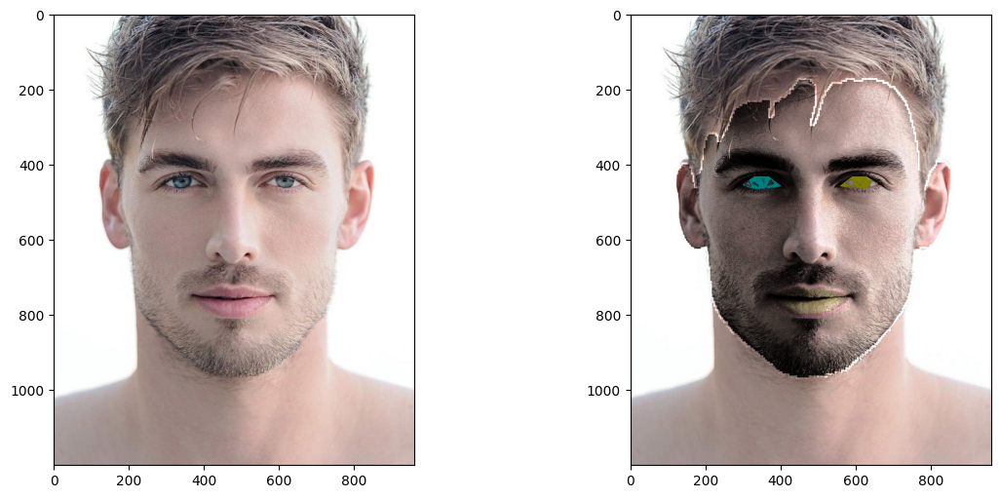

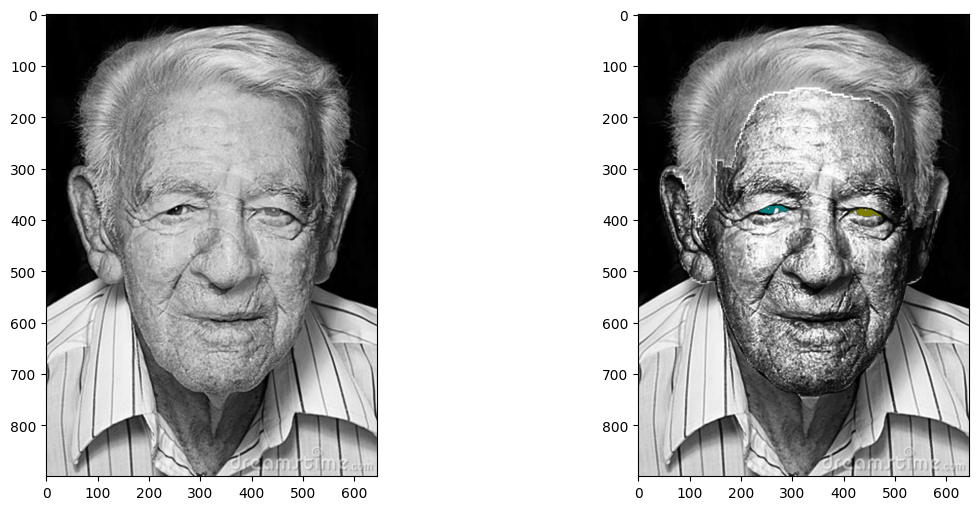

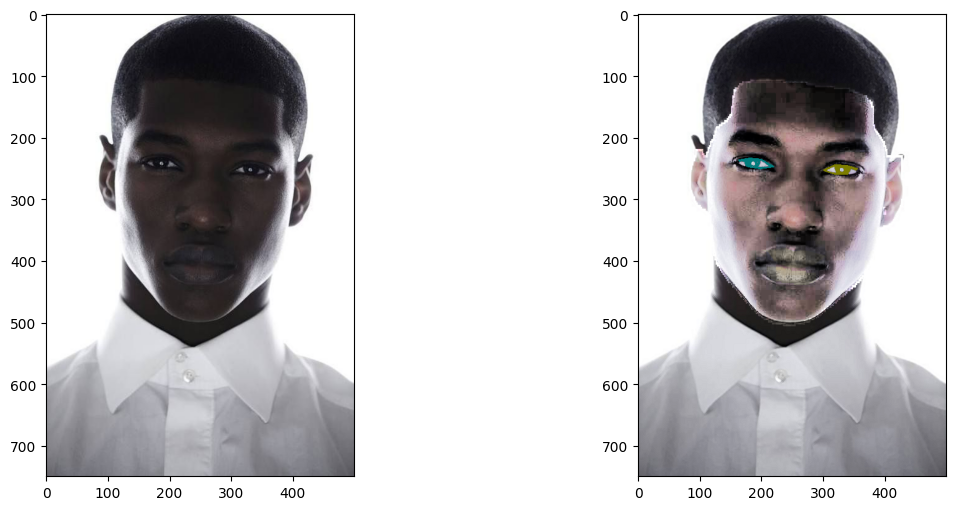

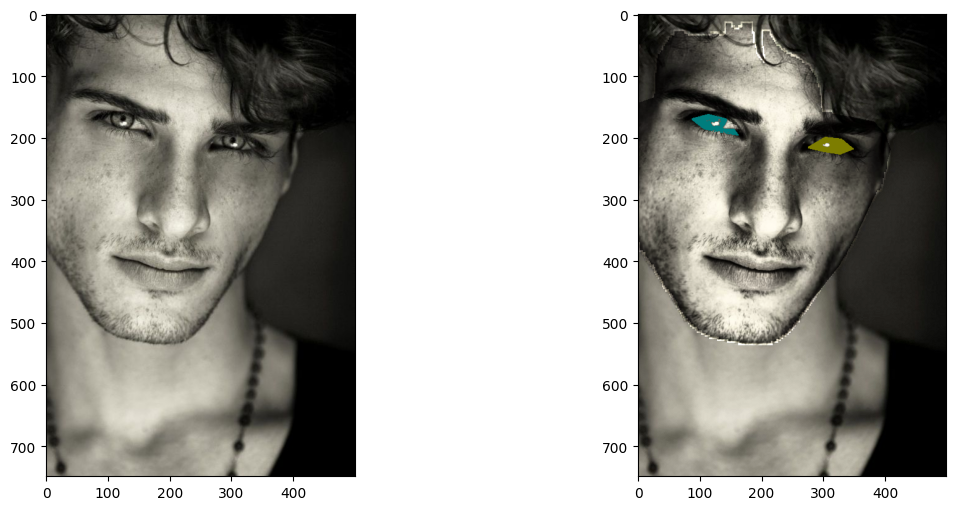

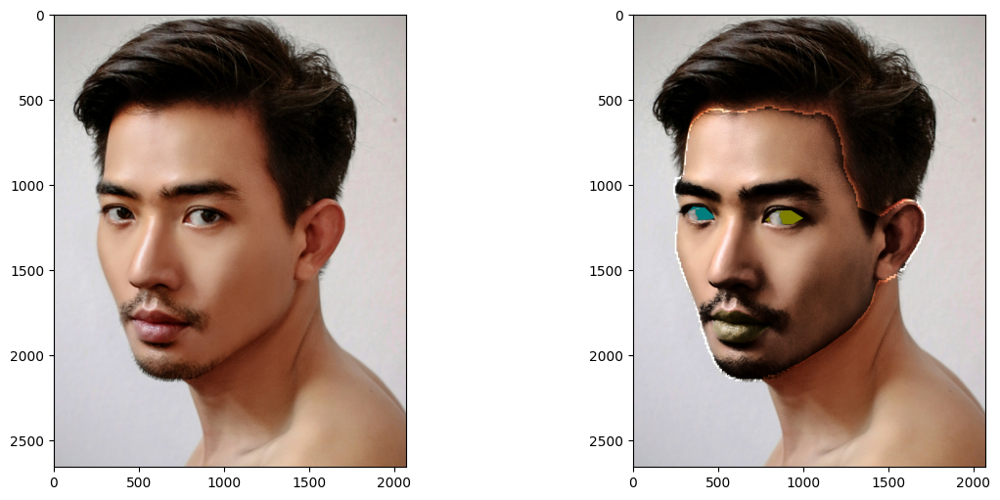

In [62]:
import random
path_img = '/content/archive'
path_markup = '/content/markup'
path_face_m = '/content/face-m'
c = 10
K = 0.0001
model.eval()
with torch.no_grad():
    for i in random.sample(range(0,100),5):
        p = os.path.join(path_img,f'1 ({i + 1}).jpg')
        image = cv2.imread(p)
        result = enhancer(image)

        original = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(14,6))
        plt.subplot(1,2,1)
        plt.imshow(original)
        plt.subplot(1,2,2)
        plt.imshow(result)
        plt.show()